<a href="https://colab.research.google.com/github/raniaabidi/XAI/blob/main/Tasks.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import userdata

# **PyXAI**

In [17]:
!pip install pyxai

  Using cached protobuf-5.26.1-cp37-abi3-manylinux2014_x86_64.whl.metadata (592 bytes)
Using cached protobuf-5.26.1-cp37-abi3-manylinux2014_x86_64.whl (302 kB)
  Attempting uninstall: protobuf
    Found existing installation: protobuf 3.20.3
    Uninstalling protobuf-3.20.3:
      Successfully uninstalled protobuf-3.20.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow-tpu 2.17.0 requires protobuf!=4.21.0,!=4.21.1,!=4.21.2,!=4.21.3,!=4.21.4,!=4.21.5,<5.0.0dev,>=3.20.3, but you have protobuf 5.26.1 which is incompatible.
tensorflow 2.17.1 requires protobuf!=4.21.0,!=4.21.1,!=4.21.2,!=4.21.3,!=4.21.4,!=4.21.5,<5.0.0dev,>=3.20.3, but you have protobuf 5.26.1 which is incompatible.


In [74]:
# Import necessary libraries
import pandas as pd
from pyxai import Learning, Explainer

# Step 1: Load the dataset
iris_data = pd.read_csv('/content/Iris.csv')

# Drop the 'Id' column if it exists
if 'Id' in iris_data.columns:
    iris_data = iris_data.drop(columns=['Id'])

# Define the feature matrix (X) and the target (y)
X = iris_data.drop(columns=['Species'])
y = iris_data['Species']

# Step 2: Use PyXAI to create a learner for the iris dataset
learner = Learning.Scikitlearn(iris_data, learner_type=Learning.CLASSIFICATION)

# Step 3: Evaluate the model
model = learner.evaluate(method=Learning.HOLD_OUT, output=Learning.DT)  # Using Decision Tree

# Step 4: Select an instance (row) from the dataset to explain
instance, prediction = learner.get_instances(model, n=1, correct=True, predictions=[0])  # Select a well-classified instance

# Step 5: Initialize the Explainer module to explain the instance
explainer = Explainer.initialize(model, instance)

# Step 6: Check if the explainer was initialized
if explainer is not None:
    # Generate the binary representation and corresponding conditions for the instance
    print("instance:", instance)
    print("binary representation:", explainer.binary_representation)
    print("conditions related to the binary representation:", explainer.to_features(explainer.binary_representation, eliminate_redundant_features=False))

    # Generate a Sufficient Reason for the instance
    sufficient_reason = explainer.sufficient_reason(n=1)
    print("sufficient_reason:", sufficient_reason)
    print("to_features (sufficient reason):", explainer.to_features(sufficient_reason))

    # Generate a Contrastive Reason for a wrongly classified instance
    instance_wrong, _ = learner.get_instances(model, n=1, correct=False)
    explainer.set_instance(instance_wrong)

    contrastive_reason = explainer.contrastive_reason()
    print("contrastive_reason:", contrastive_reason)
    print("to_features (contrastive reason):", explainer.to_features(contrastive_reason, contrastive=True))

else:
    print("Error: Explainer could not be initialized. Please check the model and instance.")


data:
     SepalLengthCm  SepalWidthCm  PetalLengthCm  PetalWidthCm         Species
0              5.1           3.5            1.4           0.2     Iris-setosa
1              4.9           3.0            1.4           0.2     Iris-setosa
2              4.7           3.2            1.3           0.2     Iris-setosa
3              4.6           3.1            1.5           0.2     Iris-setosa
4              5.0           3.6            1.4           0.2     Iris-setosa
..             ...           ...            ...           ...             ...
145            6.7           3.0            5.2           2.3  Iris-virginica
146            6.3           2.5            5.0           1.9  Iris-virginica
147            6.5           3.0            5.2           2.0  Iris-virginica
148            6.2           3.4            5.4           2.3  Iris-virginica
149            5.9           3.0            5.1           1.8  Iris-virginica

[150 rows x 5 columns]
--------------   Information   ---

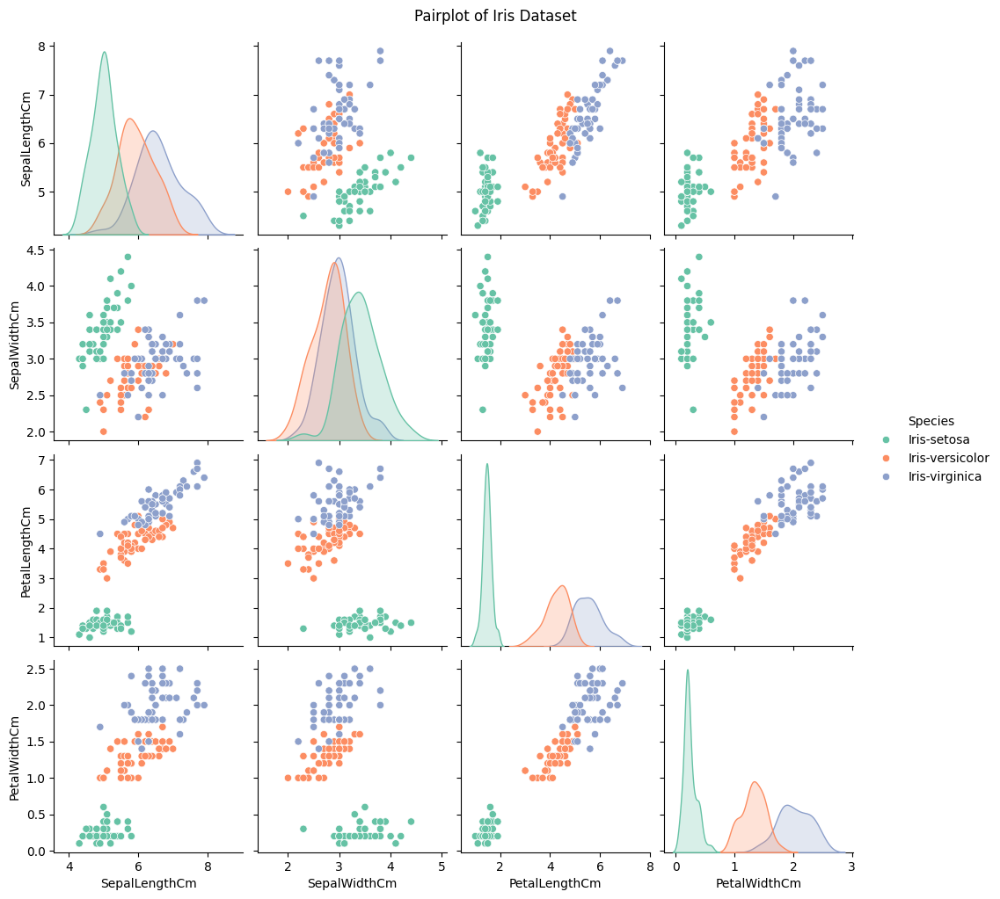

<ipython-input-166-5c67e5f3ccc4>:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Species", y=feature, data=iris_data, palette="Set2")
<ipython-input-166-5c67e5f3ccc4>:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Species", y=feature, data=iris_data, palette="Set2")
<ipython-input-166-5c67e5f3ccc4>:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Species", y=feature, data=iris_data, palette="Set2")
<ipython-input-166-5c67e5f3ccc4>:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed 

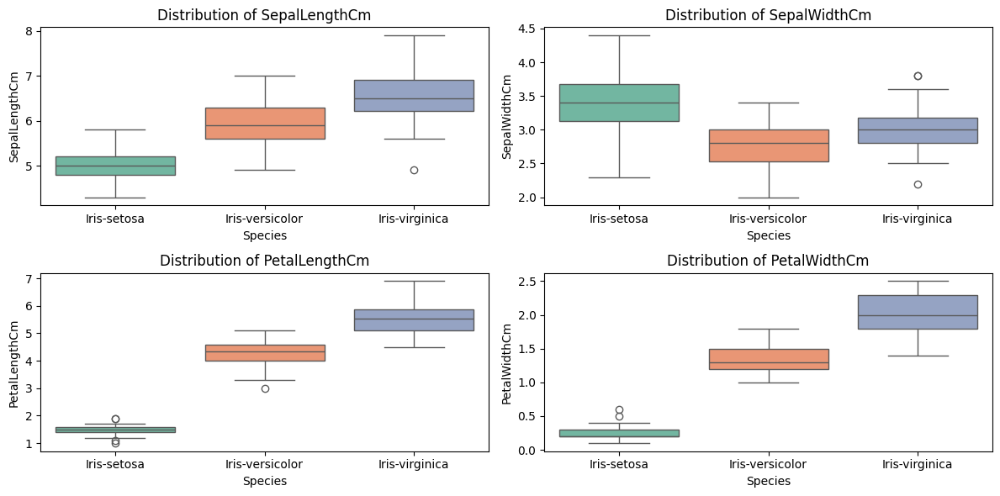

In [166]:
import matplotlib.pyplot as plt
import seaborn as sns

# Pairplot to visualize relationships between features
sns.pairplot(iris_data, hue="Species", palette="Set2")
plt.suptitle("Pairplot of Iris Dataset", y=1.02)
plt.show()

# Boxplot to visualize feature distributions by species
plt.figure(figsize=(12, 6))
for i, feature in enumerate(X.columns):
    plt.subplot(2, 2, i + 1)
    sns.boxplot(x="Species", y=feature, data=iris_data, palette="Set2")
    plt.title(f"Distribution of {feature}")
plt.tight_layout()
plt.show()

# Fidelity **score**

In [121]:
# Import necessary libraries
import pandas as pd
import numpy as np
from pyxai import Learning, Explainer
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

# Step 1: Load the dataset
iris_data = pd.read_csv('/content/Iris.csv')

# Drop the 'Id' column if it exists
if 'Id' in iris_data.columns:
    iris_data = iris_data.drop(columns=['Id'])

# Define the feature matrix (X) and the target (y)
X = iris_data.drop(columns=['Species'])
y = iris_data['Species']

# Step 2: Train a More Complex PyXAI Learner (Random Forest)
learner = Learning.Scikitlearn(iris_data, learner_type=Learning.CLASSIFICATION)

# Correctly pass RF parameters
model = learner.evaluate(method=Learning.HOLD_OUT, output=Learning.RF, max_depth=10, random_state=0)

# Step 3: Extract multiple test instances and their explanations
n_samples = 20  # Number of instances to evaluate fidelity
original_predictions = []
explanation_predictions = []

for i in range(n_samples):
    instance, prediction = learner.get_instances(model, n=1, correct=True)

    # Initialize the PyXAI Explainer
    explainer = Explainer.initialize(model, instance)
    if explainer is None:
        print(f"[{i}] Explainer could not be initialized. Skipping instance.")
        continue  # Skip if the explainer fails

    # Only use sufficient reason for RF (contrastive reason is not available)
    sufficient_reason = explainer.sufficient_reason()

    # DEBUG: Print explanation
    print(f"[{i}] Sufficient Reason: {sufficient_reason}")

    # Check if the explanation is valid
    if sufficient_reason == (-1,) or sufficient_reason == -1:
        print(f"[{i}] Invalid explanation (-1). Skipping instance.")
        continue

    try:
        # Extract only valid feature indices
        valid_features = [abs(f) - 1 for f in sufficient_reason if f < 0 and abs(f) - 1 < X.shape[1]]
    except TypeError:
        print(f"[{i}] TypeError in feature extraction. Skipping instance.")
        continue

    # DEBUG: Print extracted valid feature indices
    print(f"[{i}] Valid Feature Indices: {valid_features}")

    if not valid_features:
        print(f"[{i}] No valid features extracted. Skipping instance.")
        continue  # Skip if no valid features are found

    # Reduce instance to the explained features
    simplified_instance = [instance[j] for j in valid_features]

    # Store the original prediction
    original_predictions.append(prediction)

    #  Train a surrogate Decision Tree with the correct feature names
    surrogate_model = DecisionTreeClassifier(max_depth=3)
    surrogate_model.fit(X.iloc[:, valid_features], y)  # Train on explained features
    surrogate_prediction = surrogate_model.predict(pd.DataFrame([simplified_instance], columns=X.columns[valid_features]))[0]

    # Store the prediction from the surrogate explanation
    explanation_predictions.append(surrogate_prediction)

# Step 4: Compute Fidelity Score
if original_predictions and explanation_predictions:
    fidelity = accuracy_score(original_predictions, explanation_predictions)
    print(f"Fidelity Score: {fidelity:.4f}")
else:
    print("Error: No valid explanations were generated.")


data:
     SepalLengthCm  SepalWidthCm  PetalLengthCm  PetalWidthCm         Species
0              5.1           3.5            1.4           0.2     Iris-setosa
1              4.9           3.0            1.4           0.2     Iris-setosa
2              4.7           3.2            1.3           0.2     Iris-setosa
3              4.6           3.1            1.5           0.2     Iris-setosa
4              5.0           3.6            1.4           0.2     Iris-setosa
..             ...           ...            ...           ...             ...
145            6.7           3.0            5.2           2.3  Iris-virginica
146            6.3           2.5            5.0           1.9  Iris-virginica
147            6.5           3.0            5.2           2.0  Iris-virginica
148            6.2           3.4            5.4           2.3  Iris-virginica
149            5.9           3.0            5.1           1.8  Iris-virginica

[150 rows x 5 columns]
--------------   Information   ---

# Stability Score **PyXAI**

In [122]:
# Import necessary libraries
import pandas as pd
import numpy as np
from pyxai import Learning, Explainer
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

# Step 1: Load the dataset
iris_data = pd.read_csv('/content/Iris.csv')

# Drop the 'Id' column if it exists
if 'Id' in iris_data.columns:
    iris_data = iris_data.drop(columns=['Id'])

# Define the feature matrix (X) and the target (y)
X = iris_data.drop(columns=['Species'])
y = iris_data['Species']

# Step 2: Train a PyXAI Learner (Random Forest)
learner = Learning.Scikitlearn(iris_data, learner_type=Learning.CLASSIFICATION)

# Train a Random Forest model with proper parameters
model = learner.evaluate(method=Learning.HOLD_OUT, output=Learning.RF, max_depth=10, random_state=0)

# Step 3: Compute Stability Score for Multiple Instances
n_samples = 20  # Number of instances to evaluate stability
stability_scores = []

for i in range(n_samples):
    instance, prediction = learner.get_instances(model, n=1, correct=True)

    # Initialize the PyXAI Explainer
    explainer = Explainer.initialize(model, instance)
    if explainer is None:
        print(f"[{i}] Explainer could not be initialized. Skipping instance.")
        continue  # Skip if the explainer fails

    # Generate explanation for the original instance
    sufficient_reason_x = explainer.sufficient_reason()

    # Check if the explanation is valid
    if sufficient_reason_x == (-1,) or sufficient_reason_x == -1:
        print(f"[{i}] Invalid explanation (-1). Skipping instance.")
        continue

    # Convert explanation into feature indices
    valid_features_x = [abs(f) - 1 for f in sufficient_reason_x if f < 0 and abs(f) - 1 < X.shape[1]]

    # DEBUG: Print extracted valid feature indices
    print(f"[{i}] Original Explanation Features: {valid_features_x}")

    if not valid_features_x:
        print(f"[{i}] No valid features extracted. Skipping instance.")
        continue  # Skip if no valid features are found

    # Apply small perturbation (δx) to the instance
    noise_level = 0.05  # Small noise percentage
    perturbed_instance = instance.copy()
    for j in range(len(perturbed_instance)):
        perturbed_instance[j] += np.random.uniform(-noise_level, noise_level)  # Apply small random perturbation

    # Get explanation for the perturbed instance
    explainer.set_instance(perturbed_instance)
    sufficient_reason_x_dx = explainer.sufficient_reason()

    # Check if the perturbed explanation is valid
    if sufficient_reason_x_dx == (-1,) or sufficient_reason_x_dx == -1:
        print(f"[{i}] Invalid perturbed explanation (-1). Skipping instance.")
        continue

    # Convert explanation into feature indices for perturbed instance
    valid_features_x_dx = [abs(f) - 1 for f in sufficient_reason_x_dx if f < 0 and abs(f) - 1 < X.shape[1]]

    # DEBUG: Print extracted valid feature indices for perturbed instance
    print(f"[{i}] Perturbed Explanation Features: {valid_features_x_dx}")

    if not valid_features_x_dx:
        print(f"[{i}] No valid features extracted for perturbed instance. Skipping instance.")
        continue  # Skip if no valid features are found

    # Compute stability score
    norm_diff = len(set(valid_features_x) - set(valid_features_x_dx))
    norm_original = len(valid_features_x) if len(valid_features_x) > 0 else 1  # Avoid division by zero

    stability = 1 - (norm_diff / norm_original)
    stability_scores.append(stability)

    print(f"[{i}] Stability Score: {stability:.4f}")

# Step 4: Compute Average Stability Score
if stability_scores:
    avg_stability = np.mean(stability_scores)
    print(f" Average Stability Score: {avg_stability:.4f}")
else:
    print(" Error: No valid stability scores were generated.")


data:
     SepalLengthCm  SepalWidthCm  PetalLengthCm  PetalWidthCm         Species
0              5.1           3.5            1.4           0.2     Iris-setosa
1              4.9           3.0            1.4           0.2     Iris-setosa
2              4.7           3.2            1.3           0.2     Iris-setosa
3              4.6           3.1            1.5           0.2     Iris-setosa
4              5.0           3.6            1.4           0.2     Iris-setosa
..             ...           ...            ...           ...             ...
145            6.7           3.0            5.2           2.3  Iris-virginica
146            6.3           2.5            5.0           1.9  Iris-virginica
147            6.5           3.0            5.2           2.0  Iris-virginica
148            6.2           3.4            5.4           2.3  Iris-virginica
149            5.9           3.0            5.1           1.8  Iris-virginica

[150 rows x 5 columns]
--------------   Information   ---

# Predictive Explanation Concordance (**PEC**)

In [165]:
# Import necessary libraries
import pandas as pd
import numpy as np
from pyxai import Learning, Explainer
from sklearn.metrics import accuracy_score

# Step 1: Load the dataset
iris_data = pd.read_csv('/content/Iris.csv')

# Drop the 'Id' column if it exists
if 'Id' in iris_data.columns:
    iris_data = iris_data.drop(columns=['Id'])

# Define the feature matrix (X) and the target (y)
X = iris_data.drop(columns=['Species'])
y = iris_data['Species']

# Step 2: Train a PyXAI Learner (Random Forest)
learner = Learning.Scikitlearn(iris_data, learner_type=Learning.CLASSIFICATION)

# Train a Random Forest model
model = learner.evaluate(method=Learning.HOLD_OUT, output=Learning.RF, max_depth=10, random_state=0)

# Step 3: Compute PEC Score for Multiple Instances
n_samples = 20  # Number of instances to evaluate PEC
pec_scores = []

for i in range(n_samples):
    instance, prediction = learner.get_instances(model, n=1, correct=True)

    # Initialize the PyXAI Explainer
    explainer = Explainer.initialize(model, instance)
    if explainer is None:
        continue  # Skip if the explainer fails

    # Get sufficient reason explanation
    sufficient_reason = explainer.sufficient_reason()

    if sufficient_reason == (-1,) or sufficient_reason == -1:
        continue

    try:
        # Extract valid feature indices
        valid_features = [abs(f) - 1 for f in sufficient_reason if f < 0 and abs(f) - 1 < X.shape[1]]
    except TypeError:
        continue

    if not valid_features:
        continue  # Skip if no valid features are found

    # Define important and unimportant features
    important_features = valid_features
    unimportant_features = list(set(range(X.shape[1])) - set(important_features))

    # Compute prediction confidence with the original instance
    original_prediction = explainer.predict(instance)  # Use the explainer's predict method
    original_confidence = 1.0 if prediction == original_prediction else 0.0

    # Compute confidence with only important features
    masked_instance_I = np.array(instance)
    masked_instance_I[unimportant_features] = np.mean(X.iloc[:, unimportant_features], axis=0)
    masked_prediction_I = explainer.predict(masked_instance_I)  # Use the explainer's predict method
    confidence_I = 1.0 if masked_prediction_I == original_prediction else 0.0

    # Compute confidence with only unimportant features
    masked_instance_U = np.array(instance)
    masked_instance_U[important_features] = np.mean(X.iloc[:, important_features], axis=0)
    masked_prediction_U = explainer.predict(masked_instance_U)  # Use the explainer's predict method
    confidence_U = 1.0 if masked_prediction_U == original_prediction else 0.0

    # Compute PEC Score
    delta_f_I = original_confidence - confidence_I
    delta_f_U = original_confidence - confidence_U

    if delta_f_I + delta_f_U > 0:
        pec_score = delta_f_I / (delta_f_I + delta_f_U)
        pec_scores.append(pec_score)

# Step 4: Compute Average PEC Score
if pec_scores:
    avg_pec_score = np.mean(pec_scores)
    print(f"PEC Score: {avg_pec_score:.4f}")
else:
    print("Error: No valid PEC scores were generated.")


data:
     SepalLengthCm  SepalWidthCm  PetalLengthCm  PetalWidthCm         Species
0              5.1           3.5            1.4           0.2     Iris-setosa
1              4.9           3.0            1.4           0.2     Iris-setosa
2              4.7           3.2            1.3           0.2     Iris-setosa
3              4.6           3.1            1.5           0.2     Iris-setosa
4              5.0           3.6            1.4           0.2     Iris-setosa
..             ...           ...            ...           ...             ...
145            6.7           3.0            5.2           2.3  Iris-virginica
146            6.3           2.5            5.0           1.9  Iris-virginica
147            6.5           3.0            5.2           2.0  Iris-virginica
148            6.2           3.4            5.4           2.3  Iris-virginica
149            5.9           3.0            5.1           1.8  Iris-virginica

[150 rows x 5 columns]
--------------   Information   ---

# Sparcity **Score**

In [123]:
# Import necessary libraries
import pandas as pd
import numpy as np
from pyxai import Learning, Explainer
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

# Step 1: Load the dataset
iris_data = pd.read_csv('/content/Iris.csv')

# Drop the 'Id' column if it exists
if 'Id' in iris_data.columns:
    iris_data = iris_data.drop(columns=['Id'])

# Define the feature matrix (X) and the target (y)
X = iris_data.drop(columns=['Species'])
y = iris_data['Species']

# Step 2: Train a PyXAI Learner (Random Forest)
learner = Learning.Scikitlearn(iris_data, learner_type=Learning.CLASSIFICATION)

# Train a Random Forest model with proper parameters
model = learner.evaluate(method=Learning.HOLD_OUT, output=Learning.RF, max_depth=10, random_state=0)

# Step 3: Compute Sparsity Score for Multiple Instances
n_samples = 20  # Number of instances to evaluate sparsity
sparsity_scores = []

for i in range(n_samples):
    instance, prediction = learner.get_instances(model, n=1, correct=True)

    # Initialize the PyXAI Explainer
    explainer = Explainer.initialize(model, instance)
    if explainer is None:
        print(f"[{i}] Explainer could not be initialized. Skipping instance.")
        continue  # Skip if the explainer fails

    # Generate explanation for the original instance
    sufficient_reason_x = explainer.sufficient_reason()

    # Check if the explanation is valid
    if sufficient_reason_x == (-1,) or sufficient_reason_x == -1:
        print(f"[{i}] Invalid explanation (-1). Skipping instance.")
        continue

    # Convert explanation into feature indices
    valid_features_x = [abs(f) - 1 for f in sufficient_reason_x if f < 0 and abs(f) - 1 < X.shape[1]]

    # DEBUG: Print extracted valid feature indices
    print(f"[{i}] Explanation Features: {valid_features_x}")

    if not valid_features_x:
        print(f"[{i}] No valid features extracted. Skipping instance.")
        continue  # Skip if no valid features are found

    # Compute sparsity score
    sparsity = 1 - (len(valid_features_x) / X.shape[1])
    sparsity_scores.append(sparsity)

    print(f"[{i}] Sparsity Score: {sparsity:.4f}")

# Step 4: Compute Average Sparsity Score
if sparsity_scores:
    avg_sparsity = np.mean(sparsity_scores)
    print(f"Average Sparsity Score: {avg_sparsity:.4f}")
else:
    print("Error: No valid sparsity scores were generated.")


data:
     SepalLengthCm  SepalWidthCm  PetalLengthCm  PetalWidthCm         Species
0              5.1           3.5            1.4           0.2     Iris-setosa
1              4.9           3.0            1.4           0.2     Iris-setosa
2              4.7           3.2            1.3           0.2     Iris-setosa
3              4.6           3.1            1.5           0.2     Iris-setosa
4              5.0           3.6            1.4           0.2     Iris-setosa
..             ...           ...            ...           ...             ...
145            6.7           3.0            5.2           2.3  Iris-virginica
146            6.3           2.5            5.0           1.9  Iris-virginica
147            6.5           3.0            5.2           2.0  Iris-virginica
148            6.2           3.4            5.4           2.3  Iris-virginica
149            5.9           3.0            5.1           1.8  Iris-virginica

[150 rows x 5 columns]
--------------   Information   ---

# Robustness **Score**

In [125]:
# Import necessary libraries
import pandas as pd
import numpy as np
from pyxai import Learning, Explainer
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

# Step 1: Load the dataset
iris_data = pd.read_csv('/content/Iris.csv')

# Drop the 'Id' column if it exists
if 'Id' in iris_data.columns:
    iris_data = iris_data.drop(columns=['Id'])

# Define the feature matrix (X) and the target (y)
X = iris_data.drop(columns=['Species'])
y = iris_data['Species']

# Step 2: Train a PyXAI Learner (Random Forest)
learner = Learning.Scikitlearn(iris_data, learner_type=Learning.CLASSIFICATION)

# Train a Random Forest model with proper parameters
model = learner.evaluate(method=Learning.HOLD_OUT, output=Learning.RF, max_depth=10, random_state=0)

# Step 3: Compute Robustness Score for Multiple Instances
n_samples = 20  # Number of instances to evaluate robustness
robustness_scores = []

for i in range(n_samples):
    instance, prediction = learner.get_instances(model, n=1, correct=True)

    # Initialize the PyXAI Explainer
    explainer = Explainer.initialize(model, instance)
    if explainer is None:
        print(f"[{i}] Explainer could not be initialized. Skipping instance.")
        continue  # Skip if the explainer fails

    # Generate explanation for the original instance
    sufficient_reason_x = explainer.sufficient_reason()

    # Check if the explanation is valid
    if sufficient_reason_x == (-1,) or sufficient_reason_x == -1:
        print(f"[{i}] Invalid explanation (-1). Skipping instance.")
        continue

    # Convert explanation into feature indices
    valid_features_x = [abs(f) - 1 for f in sufficient_reason_x if f < 0 and abs(f) - 1 < X.shape[1]]

    # DEBUG: Print extracted valid feature indices
    print(f"[{i}] Original Explanation Features: {valid_features_x}")

    if not valid_features_x:
        print(f"[{i}] No valid features extracted. Skipping instance.")
        continue  # Skip if no valid features are found

    # Apply small perturbation (δx) to the instance
    noise_level = 0.05  # Small noise percentage
    perturbed_instance = instance.copy()
    for j in range(len(perturbed_instance)):
        perturbed_instance[j] += np.random.uniform(-noise_level, noise_level)  # Apply small random perturbation

    # Get explanation for the perturbed instance
    explainer.set_instance(perturbed_instance)
    sufficient_reason_x_dx = explainer.sufficient_reason()

    # Check if the perturbed explanation is valid
    if sufficient_reason_x_dx == (-1,) or sufficient_reason_x_dx == -1:
        print(f"[{i}] Invalid perturbed explanation (-1). Skipping instance.")
        continue

    # Convert explanation into feature indices for perturbed instance
    valid_features_x_dx = [abs(f) - 1 for f in sufficient_reason_x_dx if f < 0 and abs(f) - 1 < X.shape[1]]

    # DEBUG: Print extracted valid feature indices for perturbed instance
    print(f"[{i}] Perturbed Explanation Features: {valid_features_x_dx}")

    if not valid_features_x_dx:
        print(f"[{i}] No valid features extracted for perturbed instance. Skipping instance.")
        continue  # Skip if no valid features are found

    # Compute robustness score using the correct formula
    norm_original = len(valid_features_x) if len(valid_features_x) > 0 else 1  # Avoid division by zero
    norm_diff = len(set(valid_features_x) - set(valid_features_x_dx))  # Number of differing features

    robustness = 1 - (norm_diff / norm_original)  # Ensures robustness is between 0 and 1
    robustness_scores.append(robustness)

    print(f"[{i}] Robustness Score: {robustness:.4f}")

# Step 4: Compute Average Robustness Score
if robustness_scores:
    avg_robustness = np.mean(robustness_scores)
    print(f"Average Robustness Score: {avg_robustness:.4f}")
else:
    print(" Error: No valid robustness scores were generated.")


data:
     SepalLengthCm  SepalWidthCm  PetalLengthCm  PetalWidthCm         Species
0              5.1           3.5            1.4           0.2     Iris-setosa
1              4.9           3.0            1.4           0.2     Iris-setosa
2              4.7           3.2            1.3           0.2     Iris-setosa
3              4.6           3.1            1.5           0.2     Iris-setosa
4              5.0           3.6            1.4           0.2     Iris-setosa
..             ...           ...            ...           ...             ...
145            6.7           3.0            5.2           2.3  Iris-virginica
146            6.3           2.5            5.0           1.9  Iris-virginica
147            6.5           3.0            5.2           2.0  Iris-virginica
148            6.2           3.4            5.4           2.3  Iris-virginica
149            5.9           3.0            5.1           1.8  Iris-virginica

[150 rows x 5 columns]
--------------   Information   ---

# Tabular-**data**

In [ ]:
!pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 5.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=8bbf099b2bed3982f75b181ca813080b75e9e0c6ae239bd5c4bf88937517e581
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


# **LIME**

# Iris **Data**

# Predictive Explanation Concordance (PEC)

In [ ]:
# Import necessary libraries
import pandas as pd
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
import lime
import lime.lime_tabular
from google.colab import drive
import zipfile
import numpy as np

# Step 1: Mount Google Drive
drive.mount('/content/drive')

# Step 2: Unzip the archive (adjust path if necessary)
def unzip_data(zip_path, extract_to='/content'):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to)

# Unzipping the dataset (adjust path as needed)
unzip_data('/content/drive/MyDrive/Iris.zip')

# Load the dataset
iris_data = pd.read_csv('/content/Iris.csv')

# Drop the 'Id' column as it's not a useful feature
iris_data = iris_data.drop(columns=['Id'])

# Define the feature matrix (X) and the target (y)
X = iris_data.drop(columns=['Species'])
y = iris_data['Species']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the Random Forest Classifier
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)

# Train the model on the training data
rf_model.fit(X_train, y_train)

# Make predictions on the test data
y_pred = rf_model.predict(X_test)

# Evaluate the model's accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f'Random Forest model accuracy on test data: {accuracy * 100:.2f}%')

# Cross-Validation Score (to avoid overfitting)
cross_val_accuracy = cross_val_score(rf_model, X_train, y_train, cv=5).mean()
print(f'Cross-Validation Accuracy: {cross_val_accuracy * 100:.2f}%')

# Step 3: Initialize the LIME explainer for tabular data
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train.values,
    feature_names=X_train.columns,
    class_names=y_train.unique(),
    mode='classification'
)

# Select an instance (row) from the test set to explain
instance = X_test.iloc[0].values  # First test sample

# Generate an explanation for the instance
explanation = explainer.explain_instance(data_row=instance, predict_fn=rf_model.predict_proba)

# Display the explanation
explanation.show_in_notebook(show_table=True)

# Step 4: Define a function to map LIME's feature name back to the original feature name
def get_original_feature_name(feature_str):
    for feature_name in X_train.columns:
        if feature_name in feature_str:
            return feature_name
    return None

# Step 5: Define a function to perturb the instance based on important/unimportant features
def perturb_instance(instance, explanation, important=True):
    """
    Perturbs the instance based on important or unimportant features from the explanation.
    If `important` is True, perturb important features; otherwise, perturb unimportant features.
    """
    perturbed_instance = instance.copy()

    # Get feature importance weights from the explanation
    feature_importance = {name: score for name, score in explanation.as_list()}

    # Sort features by importance
    sorted_features = sorted(feature_importance.items(), key=lambda x: abs(x[1]), reverse=True)

    if important:
        # Perturb the most important features
        for feature_name, _ in sorted_features[:len(sorted_features)//2]:
            original_feature_name = get_original_feature_name(feature_name)
            if original_feature_name:
                feature_idx = list(X_train.columns).index(original_feature_name)
                # Set the value to 0 (you can choose other perturbation methods, e.g., mean, noise, etc.)
                perturbed_instance[feature_idx] = 0
    else:
        # Perturb the least important features
        for feature_name, _ in sorted_features[len(sorted_features)//2:]:
            original_feature_name = get_original_feature_name(feature_name)
            if original_feature_name:
                feature_idx = list(X_train.columns).index(original_feature_name)
                # Set the value to 0 (you can choose other perturbation methods)
                perturbed_instance[feature_idx] = 0

    return perturbed_instance

# Step 6: Define the PEC calculation
def calculate_pec(model, instance, explanation):
    """
    Calculates the Predictive Explanation Concordance (PEC) score.
    """
    # Get original prediction for the instance
    original_pred = model.predict_proba(instance.reshape(1, -1))[0]

    # Perturb instance by important and unimportant features
    perturbed_important = perturb_instance(instance, explanation, important=True)
    perturbed_unimportant = perturb_instance(instance, explanation, important=False)

    # Get predictions for perturbed instances
    pred_important = model.predict_proba(perturbed_important.reshape(1, -1))[0]
    pred_unimportant = model.predict_proba(perturbed_unimportant.reshape(1, -1))[0]

    # Calculate prediction changes
    delta_f_important = np.abs(original_pred - pred_important).sum()
    delta_f_unimportant = np.abs(original_pred - pred_unimportant).sum()

    # Calculate PEC score
    pec_score = delta_f_important / (delta_f_important + delta_f_unimportant)
    return pec_score

# Step 7: Apply PEC to the instance
pec_score = calculate_pec(rf_model, instance, explanation)
print(f'Predictive Explanation Concordance (PEC) Score: {pec_score:.4f}')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Random Forest model accuracy on test data: 100.00%
Cross-Validation Accuracy: 94.17%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


Predictive Explanation Concordance (PEC) Score: 0.7899


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


# Fidelity **Score**

In [ ]:
# Import necessary libraries
import pandas as pd
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
import lime
import lime.lime_tabular
from google.colab import drive
import zipfile
import numpy as np

# Step 1: Mount Google Drive
drive.mount('/content/drive')

# Step 2: Unzip the archive (adjust path if necessary)
def unzip_data(zip_path, extract_to='/content'):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to)

# Unzipping the dataset (adjust path as needed)
unzip_data('/content/drive/MyDrive/Iris.zip')

# Load the dataset
iris_data = pd.read_csv('/content/Iris.csv')

# Drop the 'Id' column as it's not a useful feature
iris_data = iris_data.drop(columns=['Id'])

# Define the feature matrix (X) and the target (y)
X = iris_data.drop(columns=['Species'])
y = iris_data['Species']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the Random Forest Classifier
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)

# Train the model on the training data
rf_model.fit(X_train, y_train)

# Make predictions on the test data
y_pred = rf_model.predict(X_test)

# Evaluate the model's accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f'Random Forest model accuracy on test data: {accuracy * 100:.2f}%')

# Cross-Validation Score (to avoid overfitting)
cross_val_accuracy = cross_val_score(rf_model, X_train, y_train, cv=5).mean()
print(f'Cross-Validation Accuracy: {cross_val_accuracy * 100:.2f}%')

# Step 3: Initialize the LIME explainer for tabular data
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train.values,
    feature_names=X_train.columns,
    class_names=y_train.unique(),
    mode='classification'
)

# Select an instance (row) from the test set to explain
instance = X_test.iloc[0].values  # First test sample

# Generate an explanation for the instance
explanation = explainer.explain_instance(data_row=instance, predict_fn=rf_model.predict_proba)

# Display the explanation
explanation.show_in_notebook(show_table=True)

# Step 4: Calculate the Fidelity Score (FS)
def calculate_fidelity_score(explanation, model, instance):
    # Get original prediction probabilities for the instance
    original_prediction = model.predict_proba(instance.reshape(1, -1))[0]

    # Get local predictions from the LIME model
    local_pred_probs = explanation.local_pred  # Accessing the local predictions directly

    # Calculate fidelity as the mean squared error between the original predictions and the local model predictions
    fidelity_score = np.mean((original_prediction - local_pred_probs) ** 2)

    return fidelity_score

# Step 5: Apply the Fidelity Score calculation
fidelity_score = calculate_fidelity_score(explanation, rf_model, instance)
print(f'Fidelity Score: {fidelity_score:.4f}')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Random Forest model accuracy on test data: 100.00%
Cross-Validation Accuracy: 94.17%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


Fidelity Score: 0.3584


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


# Sparcity **Score**

In [ ]:
# Import necessary libraries
import pandas as pd
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
import lime
import lime.lime_tabular
from google.colab import drive
import zipfile
import numpy as np

# Step 1: Mount Google Drive
drive.mount('/content/drive')

# Step 2: Unzip the archive (adjust path if necessary)
def unzip_data(zip_path, extract_to='/content'):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to)

# Unzipping the dataset (adjust path as needed)
unzip_data('/content/drive/MyDrive/Iris.zip')

# Load the dataset
iris_data = pd.read_csv('/content/Iris.csv')

# Drop the 'Id' column as it's not a useful feature
iris_data = iris_data.drop(columns=['Id'])

# Define the feature matrix (X) and the target (y)
X = iris_data.drop(columns=['Species'])
y = iris_data['Species']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the Random Forest Classifier
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)

# Train the model on the training data
rf_model.fit(X_train, y_train)

# Make predictions on the test data
y_pred = rf_model.predict(X_test)

# Evaluate the model's accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f'Random Forest model accuracy on test data: {accuracy * 100:.2f}%')

# Cross-Validation Score (to avoid overfitting)
cross_val_accuracy = cross_val_score(rf_model, X_train, y_train, cv=5).mean()
print(f'Cross-Validation Accuracy: {cross_val_accuracy * 100:.2f}%')

# Step 3: Initialize the LIME explainer for tabular data
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train.values,
    feature_names=X_train.columns,
    class_names=y_train.unique(),
    mode='classification'
)

# Select an instance (row) from the test set to explain
instance = X_test.iloc[0].values  # First test sample

# Generate an explanation for the instance
explanation = explainer.explain_instance(data_row=instance, predict_fn=rf_model.predict_proba)

# Display the explanation
explanation.show_in_notebook(show_table=True)

# Step 4: Calculate the Sparsity Score (Sparsity)
def calculate_sparsity(explanation, total_features):
    # Extract the number of features used in the explanation
    num_features_used = len(explanation.as_map()[1])  # Explanation uses only non-zero importance features

    # Sparsity is the proportion of unused features
    sparsity_score = (total_features - num_features_used) / total_features

    return sparsity_score

# Step 5: Apply the Sparsity Score calculation
total_features = X_train.shape[1]  # Total number of features in the dataset
sparsity_score = calculate_sparsity(explanation, total_features)

print(f'Sparsity Score: {sparsity_score:.4f}')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Random Forest model accuracy on test data: 100.00%
Cross-Validation Accuracy: 94.17%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


Sparsity Score: 0.0000


# **Stability** Score

In [ ]:
# Import necessary libraries
import pandas as pd
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
import lime
import lime.lime_tabular
from google.colab import drive
import zipfile
import numpy as np
import warnings

# Suppress sklearn warnings
warnings.filterwarnings("ignore", category=UserWarning)

# Step 1: Mount Google Drive
drive.mount('/content/drive')

# Step 2: Unzip the archive (adjust path if necessary)
def unzip_data(zip_path, extract_to='/content'):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to)

# Unzipping the dataset (adjust path as needed)
unzip_data('/content/drive/MyDrive/Iris.zip')

# Load the dataset
iris_data = pd.read_csv('/content/Iris.csv')

# Drop the 'Id' column as it's not a useful feature
iris_data = iris_data.drop(columns=['Id'])

# Define the feature matrix (X) and the target (y)
X = iris_data.drop(columns=['Species'])
y = iris_data['Species']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the Random Forest Classifier
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)

# Train the model on the training data
rf_model.fit(X_train, y_train)

# Make predictions on the test data
y_pred = rf_model.predict(X_test)

# Evaluate the model's accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f'Random Forest model accuracy on test data: {accuracy * 100:.2f}%')

# Cross-Validation Score (to avoid overfitting)
cross_val_accuracy = cross_val_score(rf_model, X_train, y_train, cv=5).mean()
print(f'Cross-Validation Accuracy: {cross_val_accuracy * 100:.2f}%')

# Step 3: Initialize the LIME explainer for tabular data
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train.values,
    feature_names=X_train.columns,
    class_names=y_train.unique(),
    mode='classification'
)

# Select an instance (row) from the test set to explain
instance = X_test.iloc[0].values  # First test sample

# Generate an explanation for the instance
explanation = explainer.explain_instance(data_row=instance, predict_fn=rf_model.predict_proba)

# Display the explanation
explanation.show_in_notebook(show_table=True)

# Step 4: Calculate the Stability Score
def calculate_stability_score(explainer, instance, model, perturbations=10, noise_level=0.01):
    explanations = []
    for _ in range(perturbations):
        # Generate a perturbed instance
        perturbed_instance = instance + np.random.normal(0, noise_level, instance.shape)
        # Generate an explanation for the perturbed instance
        exp = explainer.explain_instance(data_row=perturbed_instance, predict_fn=model.predict_proba)
        explanations.append(exp.as_map()[1])  # Get feature importances from explanation

    # Calculate stability as the correlation of feature importances between explanations
    stability_scores = []
    for i in range(len(explanations)):
        for j in range(i + 1, len(explanations)):
            # Compute correlation between two explanations
            corr = np.corrcoef(explanations[i], explanations[j])[0, 1]
            stability_scores.append(corr)

    # Average correlation as the stability score
    stability_score = np.mean(stability_scores) if stability_scores else 0
    return stability_score

# Step 5: Apply the Stability Score calculation
stability_score = calculate_stability_score(explainer, instance, rf_model)
print(f'Stability Score: {stability_score:.4f}')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Random Forest model accuracy on test data: 100.00%
Cross-Validation Accuracy: 94.17%


Stability Score: 1.0000


# **Robustness** Scre

In [ ]:
# Import necessary libraries
import pandas as pd
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
import lime
import lime.lime_tabular
from google.colab import drive
import zipfile
import numpy as np
import warnings

# Suppress sklearn warnings
warnings.filterwarnings("ignore", category=UserWarning)

# Step 1: Mount Google Drive
drive.mount('/content/drive')

# Step 2: Unzip the archive (adjust path if necessary)
def unzip_data(zip_path, extract_to='/content'):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to)

# Unzipping the dataset (adjust path as needed)
unzip_data('/content/drive/MyDrive/Iris.zip')

# Load the dataset
iris_data = pd.read_csv('/content/Iris.csv')

# Drop the 'Id' column as it's not a useful feature
iris_data = iris_data.drop(columns=['Id'])

# Define the feature matrix (X) and the target (y)
X = iris_data.drop(columns=['Species'])
y = iris_data['Species']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the Random Forest Classifier
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)

# Train the model on the training data
rf_model.fit(X_train, y_train)

# Make predictions on the test data
y_pred = rf_model.predict(X_test)

# Evaluate the model's accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f'Random Forest model accuracy on test data: {accuracy * 100:.2f}%')

# Cross-Validation Score (to avoid overfitting)
cross_val_accuracy = cross_val_score(rf_model, X_train, y_train, cv=5).mean()
print(f'Cross-Validation Accuracy: {cross_val_accuracy * 100:.2f}%')

# Step 3: Initialize the LIME explainer for tabular data
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train.values,
    feature_names=X_train.columns,
    class_names=y_train.unique(),
    mode='classification'
)

# Select an instance (row) from the test set to explain
instance = X_test.iloc[0].values  # First test sample

# Generate an explanation for the instance
explanation = explainer.explain_instance(data_row=instance, predict_fn=rf_model.predict_proba)

# Display the explanation
explanation.show_in_notebook(show_table=True)

# Step 4: Calculate the Robustness Score for each feature and overall score
def calculate_robustness_score(explainer, instance, model, perturbations=100, noise_level=0.01):
    feature_importance_values = []

    for _ in range(perturbations):
        # Generate a perturbed instance
        perturbed_instance = instance + np.random.normal(0, noise_level, instance.shape)
        # Generate an explanation for the perturbed instance
        exp = explainer.explain_instance(data_row=perturbed_instance, predict_fn=model.predict_proba)
        # Extract feature importances
        feature_importances = exp.as_map()[1]
        # Store feature importance values
        feature_importance_values.append([value for _, value in feature_importances])

    # Calculate robustness as the standard deviation of feature importance values
    feature_importance_values = np.array(feature_importance_values)
    robustness_scores = np.std(feature_importance_values, axis=0)  # Standard deviation along the features

    # Print robustness score for each feature
    for feature_name, score in zip(X_train.columns, robustness_scores):
        print(f'Robustness Score for {feature_name}: {score}')

    # Aggregate into a single robustness score (e.g., mean or max of robustness scores across all features)
    overall_robustness_score = np.mean(robustness_scores)  # You could also use np.max(robustness_scores) if desired
    return robustness_scores, overall_robustness_score

# Step 5: Apply the Robustness Score calculation
robustness_scores, overall_robustness_score = calculate_robustness_score(explainer, instance, rf_model)

# Print the overall robustness score
print(f'Overall Robustness Score: {overall_robustness_score}')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Random Forest model accuracy on test data: 100.00%
Cross-Validation Accuracy: 94.17%


Robustness Score for SepalLengthCm: 0.007870810315857495
Robustness Score for SepalWidthCm: 0.0074746068086041315
Robustness Score for PetalLengthCm: 0.019922050630004295
Robustness Score for PetalWidthCm: 0.01074362212498767
Overall Robustness Score: 0.0115027724698634


# SHAP Iris **Data**

In [ ]:
!pip install shap

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 540.2/540.2 kB 9.7 MB/s eta 0:00:00


In [ ]:
!pip install xgboost

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 153.9/153.9 MB 7.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 201.3/201.3 MB 5.2 MB/s eta 0:00:00


Mounted at /content/drive
Random Forest model accuracy on test data: 100.00%
Cross-Validation Accuracy: 94.17%


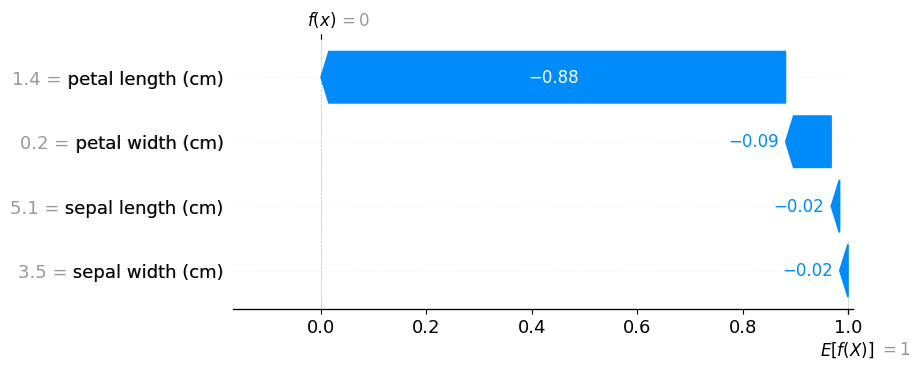

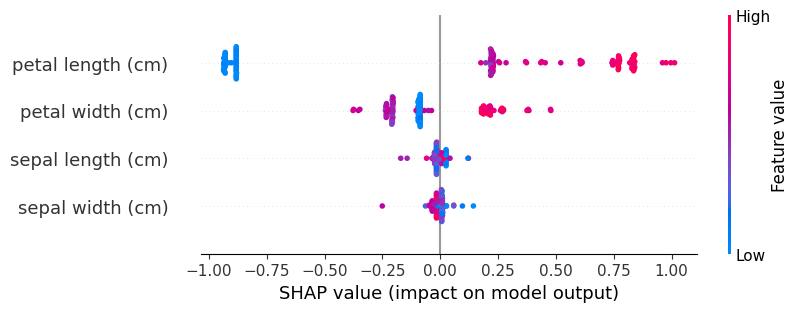

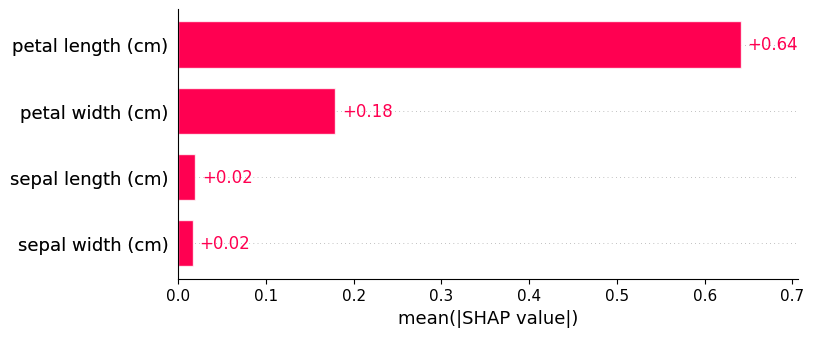

Fidelity Score: 0.2139774113893509


In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from google.colab import drive
import zipfile
import xgboost
import shap
import warnings
import numpy as np

# Step 1: Mount Google Drive
drive.mount('/content/drive')

# Step 2: Unzip the archive (adjust path if necessary)
def unzip_data(zip_path, extract_to='/content'):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to)

# Unzipping the dataset (adjust path as needed)
unzip_data('/content/drive/MyDrive/Iris.zip')

# Load the dataset
iris_data = pd.read_csv('/content/Iris.csv')

# Drop the 'Id' column as it's not a useful feature
iris_data = iris_data.drop(columns=['Id'])

# Define the feature matrix (X) and the target (y)
X = iris_data.drop(columns=['Species'])
y = iris_data['Species']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the Random Forest Classifier
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)

# Train the model on the training data
rf_model.fit(X_train, y_train)

# Make predictions on the test data
y_pred = rf_model.predict(X_test)

# Evaluate the model's accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f'Random Forest model accuracy on test data: {accuracy * 100:.2f}%')

# Cross-Validation Score (to avoid overfitting)
cross_val_accuracy = cross_val_score(rf_model, X_train, y_train, cv=5).mean()
print(f'Cross-Validation Accuracy: {cross_val_accuracy * 100:.2f}%')

# Suppress warnings
warnings.filterwarnings('ignore')

# Read Features and Target of dataset
X, y = shap.datasets.iris()

# Train XGBoost Model
model = xgboost.XGBRegressor().fit(X, y)

# Explain the model's predictions using SHAP
explainer = shap.Explainer(model)
shap_values = explainer(X)

# Visualize the first prediction's explanation
shap.plots.waterfall(shap_values[0])

# Summarize the effects of all the features
shap.plots.beeswarm(shap_values)

# Bar plot of SHAP values
shap.plots.bar(shap_values)

# Calculate and print Fidelity Score
# Fidelity score is calculated as the mean of the absolute SHAP values for all predictions
fidelity_score = np.mean(np.abs(shap_values.values))
print(f"Fidelity Score: {fidelity_score}")


In [ ]:
import numpy as np

# Fidelity Score
fidelity_score = np.mean(np.abs(shap_values.values))
print(f"Fidelity Score: {fidelity_score}")

# Stability Score
# Perturb the input data by a small amount and calculate the change in SHAP values
perturbed_X = X + np.random.normal(0, 0.01, X.shape)  # Small random perturbation
perturbed_shap_values = explainer(perturbed_X)

# Stability: 1 - ||E(x) - E(x + δx)|| / ||E(x)||
stability_score = 1 - np.linalg.norm(shap_values.values - perturbed_shap_values.values) / np.linalg.norm(shap_values.values)
# Ensure stability score is between 0 and 1
stability_score = np.clip(stability_score, 0, 1)
print(f"Stability Score: {stability_score:.4f}")

# Robustness Score
# Add larger noise to the data and observe the change in SHAP values
robustness_perturbation = np.random.normal(0, 0.1, X.shape)  # Larger noise
robustness_shap_values = explainer(X + robustness_perturbation)

# Calculate robustness: ||E(x)|| / ||E(x) - E(x + δx)||
robustness_score = np.linalg.norm(shap_values.values) / np.linalg.norm(shap_values.values - robustness_shap_values.values)
# Ensure robustness score is between 0 and 1
robustness_score = np.clip(robustness_score, 0, 1)
print(f"Robustness Score: {robustness_score:.4f}")

# Sparsity Score
# Identify important features (non-zero SHAP values)
important_features = np.sum(np.abs(shap_values.values) > 1e-6, axis=1)
# Calculate Sparsity score: 1 - (|E(x)| / |x|)
sparsity_score = 1 - np.mean(important_features) / X.shape[1]
print(f"Sparsity Score: {sparsity_score:.4f}")

# PEC Score Calculation
# Identify important features based on SHAP values (e.g., top 10 most important features)
important_features = np.argsort(np.abs(shap_values.values).mean(axis=0))[-10:]

# Perturb important features and calculate prediction changes (∆fI)
def perturb_features(X, important_indices):
    X = X.to_numpy()  # Convert X to a NumPy array
    perturbed_X = X.copy()
    perturbed_X[:, important_indices] = 0  # Set important features to 0 to perturb them
    return perturbed_X

# Perturb important features and calculate the change in predictions
X_perturbed = perturb_features(X, important_features)
perturbed_shap_values = explainer(X_perturbed)

# Calculate ∆fI (change due to important features perturbation)
delta_fI = np.sum(np.abs(shap_values.values - perturbed_shap_values.values))

# Perturb unimportant features and calculate the change in predictions (∆fU)
unimportant_features = np.argsort(np.abs(shap_values.values).mean(axis=0))[:10]
X_perturbed_unimportant = perturb_features(X, unimportant_features)
perturbed_shap_values_unimportant = explainer(X_perturbed_unimportant)

# Calculate ∆fU (change due to unimportant features perturbation)
delta_fU = np.sum(np.abs(shap_values.values - perturbed_shap_values_unimportant.values))

# Calculate PEC score
pec_score = delta_fI / (delta_fI + delta_fU)
pec_score = np.clip(pec_score, 0, 1)  # Ensure PEC score is between 0 and 1
print(f"PEC Score: {pec_score:.4f}")


Fidelity Score: 0.2139774113893509
Stability Score: 0.7841
Robustness Score: 1.0000
Sparsity Score: 0.0000
PEC Score: 0.5000


# **Titanic Dtata**

# Predictive Explanation Concordance (PEC) **Score**

In [ ]:
# Import necessary libraries
import pandas as pd
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
import lime
import lime.lime_tabular
from google.colab import drive
import zipfile
import numpy as np

# Step 1: Mount Google Drive
drive.mount('/content/drive')

# Step 2: Unzip the archive (adjust path if necessary)
def unzip_data(zip_path, extract_to='/content'):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to)

# Unzipping the Titanic dataset
unzip_data('/content/drive/MyDrive/Titanic.zip')

# Load the Titanic dataset
titanic_data = pd.read_csv('/content/Titanic-Dataset.csv')

# Check for missing values
print("Missing values before handling:\n", titanic_data.isnull().sum())

# Fill missing values
titanic_data['Age'].fillna(titanic_data['Age'].median(), inplace=True)
titanic_data['Embarked'].fillna(titanic_data['Embarked'].mode()[0], inplace=True)

# Drop columns not useful for prediction
titanic_data = titanic_data.drop(columns=['Name', 'Ticket', 'Cabin', 'PassengerId'])

# Convert categorical variables into dummy/indicator variables
titanic_data = pd.get_dummies(titanic_data, columns=['Sex', 'Embarked'], drop_first=True)

# Define the feature matrix (X) and the target (y)
X = titanic_data.drop(columns=['Survived'])
y = titanic_data['Survived']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the Random Forest Classifier
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)

# Train the model on the training data
rf_model.fit(X_train, y_train)

# Make predictions on the test data
y_pred = rf_model.predict(X_test)

# Evaluate the model's accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f'Random Forest model accuracy on test data: {accuracy * 100:.2f}%')

# Cross-Validation Score (to avoid overfitting)
cross_val_accuracy = cross_val_score(rf_model, X_train, y_train, cv=5).mean()
print(f'Cross-Validation Accuracy: {cross_val_accuracy * 100:.2f}%')

# Step 3: Initialize the LIME explainer for tabular data
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train.values,
    feature_names=X_train.columns,
    class_names=['Not Survived', 'Survived'],
    mode='classification'
)

# Select an instance (row) from the test set to explain
instance = X_test.iloc[0].values  # First test sample

# Generate an explanation for the instance
explanation = explainer.explain_instance(data_row=instance, predict_fn=rf_model.predict_proba)

# Display the explanation
explanation.show_in_notebook(show_table=True)

# Step 4: Define a function to map LIME's feature name back to the original feature name
def get_original_feature_name(feature_str):
    for feature_name in X_train.columns:
        if feature_name in feature_str:
            return feature_name
    return None

# Step 5: Define a function to perturb the instance based on important/unimportant features
def perturb_instance(instance, explanation, important=True):
    """
    Perturbs the instance based on important or unimportant features from the explanation.
    If `important` is True, perturb important features; otherwise, perturb unimportant features.
    """
    perturbed_instance = instance.copy()

    # Get feature importance weights from the explanation
    feature_importance = {name: score for name, score in explanation.as_list()}

    # Sort features by importance
    sorted_features = sorted(feature_importance.items(), key=lambda x: abs(x[1]), reverse=True)

    if important:
        # Perturb the most important features
        for feature_name, _ in sorted_features[:len(sorted_features)//2]:
            original_feature_name = get_original_feature_name(feature_name)
            if original_feature_name:
                feature_idx = list(X_train.columns).index(original_feature_name)
                # Set the value to 0 (you can choose other perturbation methods, e.g., mean, noise, etc.)
                perturbed_instance[feature_idx] = 0
    else:
        # Perturb the least important features
        for feature_name, _ in sorted_features[len(sorted_features)//2:]:
            original_feature_name = get_original_feature_name(feature_name)
            if original_feature_name:
                feature_idx = list(X_train.columns).index(original_feature_name)
                # Set the value to 0 (you can choose other perturbation methods)
                perturbed_instance[feature_idx] = 0

    return perturbed_instance

# Step 6: Define the PEC calculation
def calculate_pec(model, instance, explanation):
    """
    Calculates the Predictive Explanation Concordance (PEC) score.
    """
    # Get original prediction for the instance
    original_pred = model.predict_proba(instance.reshape(1, -1))[0]

    # Perturb instance by important and unimportant features
    perturbed_important = perturb_instance(instance, explanation, important=True)
    perturbed_unimportant = perturb_instance(instance, explanation, important=False)

    # Get predictions for perturbed instances
    pred_important = model.predict_proba(perturbed_important.reshape(1, -1))[0]
    pred_unimportant = model.predict_proba(perturbed_unimportant.reshape(1, -1))[0]

    # Calculate prediction changes
    delta_f_important = np.abs(original_pred - pred_important).sum()
    delta_f_unimportant = np.abs(original_pred - pred_unimportant).sum()

    # Calculate PEC score
    pec_score = delta_f_important / (delta_f_important + delta_f_unimportant)
    return pec_score

# Step 7: Apply PEC to the instance
pec_score = calculate_pec(rf_model, instance, explanation)
print(f'Predictive Explanation Concordance (PEC) Score: {pec_score:.4f}')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Missing values before handling:
 PassengerId      0
Survived         0
Pclass           0
Name             0
Sex              0
Age            177
SibSp            0
Parch            0
Ticket           0
Fare             0
Cabin          687
Embarked         2
dtype: int64
Random Forest model accuracy on test data: 82.12%


<ipython-input-17-ccc58f433b10>:30: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  titanic_data['Age'].fillna(titanic_data['Age'].median(), inplace=True)
<ipython-input-17-ccc58f433b10>:31: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, 

Cross-Validation Accuracy: 79.50%


Predictive Explanation Concordance (PEC) Score: 0.6338


# Fidelity **Score**

In [ ]:
# Import necessary libraries
import pandas as pd
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
import lime
import lime.lime_tabular
from google.colab import drive
import zipfile
import numpy as np

# Step 1: Mount Google Drive
drive.mount('/content/drive')

# Step 2: Unzip the archive (adjust path if necessary)
def unzip_data(zip_path, extract_to='/content'):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to)

# Unzipping the Titanic dataset
unzip_data('/content/drive/MyDrive/Titanic.zip')

# Load the Titanic dataset
titanic_data = pd.read_csv('/content/Titanic-Dataset.csv')

# Check for missing values
print("Missing values before handling:\n", titanic_data.isnull().sum())

# Fill missing values
titanic_data['Age'].fillna(titanic_data['Age'].median(), inplace=True)
titanic_data['Embarked'].fillna(titanic_data['Embarked'].mode()[0], inplace=True)

# Drop columns not useful for prediction
titanic_data = titanic_data.drop(columns=['Name', 'Ticket', 'Cabin', 'PassengerId'])

# Convert categorical variables into dummy/indicator variables
titanic_data = pd.get_dummies(titanic_data, columns=['Sex', 'Embarked'], drop_first=True)

# Define the feature matrix (X) and the target (y)
X = titanic_data.drop(columns=['Survived'])
y = titanic_data['Survived']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the Random Forest Classifier
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)

# Train the model on the training data
rf_model.fit(X_train, y_train)

# Make predictions on the test data
y_pred = rf_model.predict(X_test)

# Evaluate the model's accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f'Random Forest model accuracy on test data: {accuracy * 100:.2f}%')

# Cross-Validation Score (to avoid overfitting)
cross_val_accuracy = cross_val_score(rf_model, X_train, y_train, cv=5).mean()
print(f'Cross-Validation Accuracy: {cross_val_accuracy * 100:.2f}%')

# Step 3: Initialize the LIME explainer for tabular data
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train.values,
    feature_names=X_train.columns,
    class_names=['Not Survived', 'Survived'],
    mode='classification'
)

# Select an instance (row) from the test set to explain
instance = X_test.iloc[0].values  # First test sample

# Generate an explanation for the instance
explanation = explainer.explain_instance(data_row=instance, predict_fn=rf_model.predict_proba)

# Display the explanation
explanation.show_in_notebook(show_table=True)

# Step 4: Calculate the Fidelity Score (FS)
def calculate_fidelity_score(explanation, model, instance):
    # Get original prediction probabilities for the instance
    original_prediction = model.predict_proba(instance.reshape(1, -1))[0]

    # Get local predictions from the LIME model
    local_pred_probs = explanation.local_pred

    # Calculate fidelity as the mean squared error between the original predictions and the local model predictions
    fidelity_score = np.mean((original_prediction - local_pred_probs) ** 2)

    return fidelity_score

# Step 5: Apply the Fidelity Score calculation
fidelity_score = calculate_fidelity_score(explanation, rf_model, instance)
print(f'Fidelity Score: {fidelity_score:.4f}')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Missing values before handling:
 PassengerId      0
Survived         0
Pclass           0
Name             0
Sex              0
Age            177
SibSp            0
Parch            0
Ticket           0
Fare             0
Cabin          687
Embarked         2
dtype: int64
Random Forest model accuracy on test data: 82.12%


<ipython-input-4-902b8f472f5f>:30: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  titanic_data['Age'].fillna(titanic_data['Age'].median(), inplace=True)
<ipython-input-4-902b8f472f5f>:31: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, in

Cross-Validation Accuracy: 79.50%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


Fidelity Score: 0.1309


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


# Sparcity **Score**

In [ ]:
# Import necessary libraries
import pandas as pd
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
import lime
import lime.lime_tabular
from google.colab import drive
import zipfile
import numpy as np

# Step 1: Mount Google Drive
drive.mount('/content/drive')

# Step 2: Unzip the archive (adjust path if necessary)
def unzip_data(zip_path, extract_to='/content'):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to)

# Unzipping the Titanic dataset
unzip_data('/content/drive/MyDrive/Titanic.zip')

# Load the Titanic dataset
titanic_data = pd.read_csv('/content/Titanic-Dataset.csv')

# Check for missing values
print("Missing values before handling:\n", titanic_data.isnull().sum())

# Fill missing values
titanic_data['Age'].fillna(titanic_data['Age'].median(), inplace=True)
titanic_data['Embarked'].fillna(titanic_data['Embarked'].mode()[0], inplace=True)

# Drop columns not useful for prediction
titanic_data = titanic_data.drop(columns=['Name', 'Ticket', 'Cabin', 'PassengerId'])

# Convert categorical variables into dummy/indicator variables
titanic_data = pd.get_dummies(titanic_data, columns=['Sex', 'Embarked'], drop_first=True)

# Define the feature matrix (X) and the target (y)
X = titanic_data.drop(columns=['Survived'])
y = titanic_data['Survived']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the Random Forest Classifier
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)

# Train the model on the training data
rf_model.fit(X_train, y_train)

# Make predictions on the test data
y_pred = rf_model.predict(X_test)

# Evaluate the model's accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f'Random Forest model accuracy on test data: {accuracy * 100:.2f}%')

# Cross-Validation Score (to avoid overfitting)
cross_val_accuracy = cross_val_score(rf_model, X_train, y_train, cv=5).mean()
print(f'Cross-Validation Accuracy: {cross_val_accuracy * 100:.2f}%')

# Step 3: Initialize the LIME explainer for tabular data
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train.values,
    feature_names=X_train.columns,
    class_names=['Not Survived', 'Survived'],
    mode='classification'
)

# Select an instance (row) from the test set to explain
instance = X_test.iloc[0].values  # First test sample

# Generate an explanation for the instance
explanation = explainer.explain_instance(data_row=instance, predict_fn=rf_model.predict_proba)

# Display the explanation
explanation.show_in_notebook(show_table=True)

# Step 4: Calculate the Sparsity Score (Sparsity)
def calculate_sparsity(explanation, total_features):
    # Extract the number of features used in the explanation
    num_features_used = len(explanation.as_map()[1])  # Explanation uses only non-zero importance features

    # Sparsity is the proportion of unused features
    sparsity_score = (total_features - num_features_used) / total_features

    return sparsity_score

# Step 5: Apply the Sparsity Score calculation
total_features = X_train.shape[1]  # Total number of features in the dataset
sparsity_score = calculate_sparsity(explanation, total_features)

print(f'Sparsity Score: {sparsity_score:.4f}')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Missing values before handling:
 PassengerId      0
Survived         0
Pclass           0
Name             0
Sex              0
Age            177
SibSp            0
Parch            0
Ticket           0
Fare             0
Cabin          687
Embarked         2
dtype: int64
Random Forest model accuracy on test data: 82.12%


<ipython-input-5-8b80dd9ab219>:30: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  titanic_data['Age'].fillna(titanic_data['Age'].median(), inplace=True)
<ipython-input-5-8b80dd9ab219>:31: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, in

Cross-Validation Accuracy: 79.50%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


Sparsity Score: 0.0000


# Stability **Score**

In [ ]:
# Import necessary libraries
import pandas as pd
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
import lime
import lime.lime_tabular
from google.colab import drive
import zipfile
import numpy as np
import warnings

# Suppress sklearn warnings
warnings.filterwarnings("ignore", category=UserWarning)

# Step 1: Mount Google Drive
drive.mount('/content/drive')

# Step 2: Unzip the archive (adjust path if necessary)
def unzip_data(zip_path, extract_to='/content'):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to)

# Unzipping the Titanic dataset
unzip_data('/content/drive/MyDrive/Titanic.zip')

# Load the Titanic dataset
titanic_data = pd.read_csv('/content/Titanic-Dataset.csv')

# Check for missing values
print("Missing values before handling:\n", titanic_data.isnull().sum())

# Fill missing values
titanic_data['Age'].fillna(titanic_data['Age'].median(), inplace=True)
titanic_data['Embarked'].fillna(titanic_data['Embarked'].mode()[0], inplace=True)

# Drop columns not useful for prediction
titanic_data = titanic_data.drop(columns=['Name', 'Ticket', 'Cabin', 'PassengerId'])

# Convert categorical variables into dummy/indicator variables
titanic_data = pd.get_dummies(titanic_data, columns=['Sex', 'Embarked'], drop_first=True)

# Define the feature matrix (X) and the target (y)
X = titanic_data.drop(columns=['Survived'])
y = titanic_data['Survived']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the Random Forest Classifier
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)

# Train the model on the training data
rf_model.fit(X_train, y_train)

# Make predictions on the test data
y_pred = rf_model.predict(X_test)

# Evaluate the model's accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f'Random Forest model accuracy on test data: {accuracy * 100:.2f}%')

# Cross-Validation Score (to avoid overfitting)
cross_val_accuracy = cross_val_score(rf_model, X_train, y_train, cv=5).mean()
print(f'Cross-Validation Accuracy: {cross_val_accuracy * 100:.2f}%')

# Step 3: Initialize the LIME explainer for tabular data
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train.values,
    feature_names=X_train.columns,
    class_names=['Not Survived', 'Survived'],
    mode='classification'
)

# Select an instance (row) from the test set to explain
instance = X_test.iloc[0].values  # First test sample

# Generate an explanation for the instance
explanation = explainer.explain_instance(data_row=instance, predict_fn=rf_model.predict_proba)

# Display the explanation
explanation.show_in_notebook(show_table=True)

# Step 4: Calculate the Stability Score
def calculate_stability_score(explainer, instance, model, perturbations=10, noise_level=0.01):
    explanations = []
    for _ in range(perturbations):
        # Generate a perturbed instance
        perturbed_instance = instance + np.random.normal(0, noise_level, instance.shape)
        # Generate an explanation for the perturbed instance
        exp = explainer.explain_instance(data_row=perturbed_instance, predict_fn=model.predict_proba)
        explanations.append(exp.as_map()[1])  # Get feature importances from explanation

    # Calculate stability as the correlation of feature importances between explanations
    stability_scores = []
    for i in range(len(explanations)):
        for j in range(i + 1, len(explanations)):
            # Compute correlation between two explanations
            corr = np.corrcoef([v for k, v in explanations[i]], [v for k, v in explanations[j]])[0, 1]
            stability_scores.append(corr)

    # Average correlation as the stability score
    stability_score = np.mean(stability_scores) if stability_scores else 0
    return stability_score

# Step 5: Apply the Stability Score calculation
stability_score = calculate_stability_score(explainer, instance, rf_model)
print(f'Stability Score: {stability_score:.4f}')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Missing values before handling:
 PassengerId      0
Survived         0
Pclass           0
Name             0
Sex              0
Age            177
SibSp            0
Parch            0
Ticket           0
Fare             0
Cabin          687
Embarked         2
dtype: int64
Random Forest model accuracy on test data: 82.12%


<ipython-input-8-d6a0f92c9173>:34: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  titanic_data['Age'].fillna(titanic_data['Age'].median(), inplace=True)
<ipython-input-8-d6a0f92c9173>:35: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, in

Cross-Validation Accuracy: 79.50%


Stability Score: 0.7527


# Robustness **Score**

In [ ]:
# Import necessary libraries
import pandas as pd
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
import lime
import lime.lime_tabular
from google.colab import drive
import zipfile
import numpy as np
import warnings

# Suppress sklearn warnings
warnings.filterwarnings("ignore", category=UserWarning)

# Step 1: Mount Google Drive
drive.mount('/content/drive')

# Step 2: Unzip the archive (adjust path if necessary)
def unzip_data(zip_path, extract_to='/content'):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to)

# Unzipping the Titanic dataset
unzip_data('/content/drive/MyDrive/Titanic.zip')

# Load the Titanic dataset
titanic_data = pd.read_csv('/content/Titanic-Dataset.csv')

# Check for missing values
print("Missing values before handling:\n", titanic_data.isnull().sum())

# Fill missing values
titanic_data['Age'].fillna(titanic_data['Age'].median(), inplace=True)
titanic_data['Embarked'].fillna(titanic_data['Embarked'].mode()[0], inplace=True)

# Drop columns not useful for prediction
titanic_data = titanic_data.drop(columns=['Name', 'Ticket', 'Cabin', 'PassengerId'])

# Convert categorical variables into dummy/indicator variables
titanic_data = pd.get_dummies(titanic_data, columns=['Sex', 'Embarked'], drop_first=True)

# Define the feature matrix (X) and the target (y)
X = titanic_data.drop(columns=['Survived'])
y = titanic_data['Survived']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the Random Forest Classifier
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)

# Train the model on the training data
rf_model.fit(X_train, y_train)

# Make predictions on the test data
y_pred = rf_model.predict(X_test)

# Evaluate the model's accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f'Random Forest model accuracy on test data: {accuracy * 100:.2f}%')

# Cross-Validation Score (to avoid overfitting)
cross_val_accuracy = cross_val_score(rf_model, X_train, y_train, cv=5).mean()
print(f'Cross-Validation Accuracy: {cross_val_accuracy * 100:.2f}%')

# Step 3: Initialize the LIME explainer for tabular data
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train.values,
    feature_names=X_train.columns,
    class_names=['Not Survived', 'Survived'],
    mode='classification'
)

# Select an instance (row) from the test set to explain
instance = X_test.iloc[0].values  # First test sample

# Generate an explanation for the instance
explanation = explainer.explain_instance(data_row=instance, predict_fn=rf_model.predict_proba)

# Display the explanation
explanation.show_in_notebook(show_table=True)

# Step 4: Calculate the Robustness Score for each feature and overall score
def calculate_robustness_score(explainer, instance, model, perturbations=100, noise_level=0.01):
    feature_importance_values = []

    for _ in range(perturbations):
        # Generate a perturbed instance
        perturbed_instance = instance + np.random.normal(0, noise_level, instance.shape)
        # Generate an explanation for the perturbed instance
        exp = explainer.explain_instance(data_row=perturbed_instance, predict_fn=model.predict_proba)
        # Extract feature importances
        feature_importances = exp.as_map()[1]
        # Store feature importance values
        feature_importance_values.append([value for _, value in feature_importances])

    # Calculate robustness as the standard deviation of feature importance values
    feature_importance_values = np.array(feature_importance_values)
    robustness_scores = np.std(feature_importance_values, axis=0)  # Standard deviation along the features

    # Print robustness score for each feature
    for feature_name, score in zip(X_train.columns, robustness_scores):
        print(f'Robustness Score for {feature_name}: {score}')

    # Aggregate into a single robustness score (e.g., mean or max of robustness scores across all features)
    overall_robustness_score = np.mean(robustness_scores)  # You could also use np.max(robustness_scores) if desired
    return robustness_scores, overall_robustness_score

# Step 5: Apply the Robustness Score calculation
robustness_scores, overall_robustness_score = calculate_robustness_score(explainer, instance, rf_model)

# Print the overall robustness score
print(f'Overall Robustness Score: {overall_robustness_score}')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Missing values before handling:
 PassengerId      0
Survived         0
Pclass           0
Name             0
Sex              0
Age            177
SibSp            0
Parch            0
Ticket           0
Fare             0
Cabin          687
Embarked         2
dtype: int64
Random Forest model accuracy on test data: 82.12%


<ipython-input-10-f004b536d6b2>:34: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  titanic_data['Age'].fillna(titanic_data['Age'].median(), inplace=True)
<ipython-input-10-f004b536d6b2>:35: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, 

Cross-Validation Accuracy: 79.50%


Robustness Score for Pclass: 0.15873130949051575
Robustness Score for Age: 0.07567929603493956
Robustness Score for SibSp: 0.04417783725089421
Robustness Score for Parch: 0.03880210891667318
Robustness Score for Fare: 0.033475039601457146
Robustness Score for Sex_male: 0.02800000643152011
Robustness Score for Embarked_Q: 0.009885696623849525
Robustness Score for Embarked_S: 0.004556008261061273
Overall Robustness Score: 0.04916341282636384


# **SHAP**

In [ ]:
!pip install shap

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Missing values before handling:
 PassengerId      0
Survived         0
Pclass           0
Name             0
Sex              0
Age            177
SibSp            0
Parch            0
Ticket           0
Fare             0
Cabin          687
Embarked         2
dtype: int64
Random Forest model accuracy on test data: 82.12%
Cross-Validation Accuracy: 79.50%


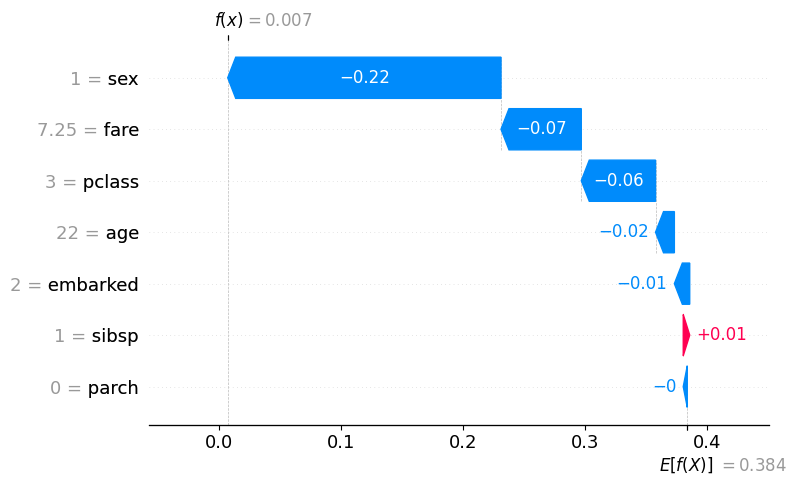

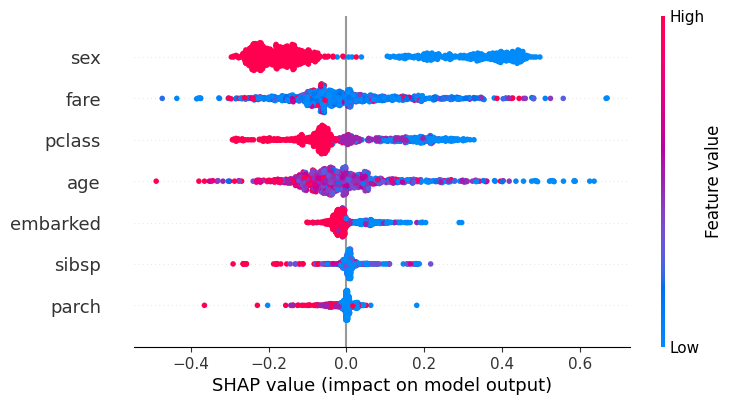

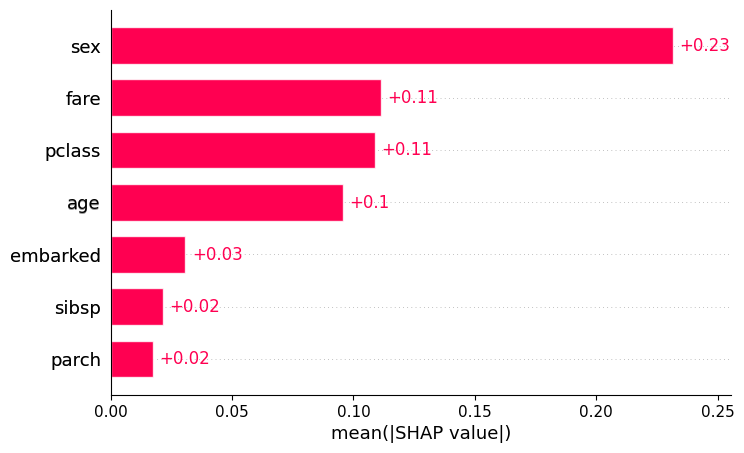

Fidelity Score: 0.0881299376487732


In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from google.colab import drive
import zipfile
import xgboost
import shap
import warnings
import numpy as np
import seaborn as sns
from sklearn.preprocessing import LabelEncoder

# Step 1: Mount Google Drive
drive.mount('/content/drive')

# Step 2: Unzip the archive (adjust path if necessary)
def unzip_data(zip_path, extract_to='/content'):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to)

# Unzipping the Titanic dataset
unzip_data('/content/drive/MyDrive/Titanic.zip')

# Load the Titanic dataset
titanic_data = pd.read_csv('/content/Titanic-Dataset.csv')

# Check for missing values
print("Missing values before handling:\n", titanic_data.isnull().sum())

# Fill missing values
titanic_data['Age'].fillna(titanic_data['Age'].median(), inplace=True)
titanic_data['Embarked'].fillna(titanic_data['Embarked'].mode()[0], inplace=True)

# Drop columns not useful for prediction
titanic_data = titanic_data.drop(columns=['Name', 'Ticket', 'Cabin', 'PassengerId'])

# Convert categorical variables into dummy/indicator variables
titanic_data = pd.get_dummies(titanic_data, columns=['Sex', 'Embarked'], drop_first=True)

# Define the feature matrix (X) and the target (y)
X = titanic_data.drop(columns=['Survived'])
y = titanic_data['Survived']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the Random Forest Classifier
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)

# Train the model on the training data
rf_model.fit(X_train, y_train)

# Make predictions on the test data
y_pred = rf_model.predict(X_test)

# Evaluate the model's accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f'Random Forest model accuracy on test data: {accuracy * 100:.2f}%')

# Cross-Validation Score (to avoid overfitting)
cross_val_accuracy = cross_val_score(rf_model, X_train, y_train, cv=5).mean()
print(f'Cross-Validation Accuracy: {cross_val_accuracy * 100:.2f}%')

# Step 3: Initialize the SHAP explainer for tree-based models
explainer = shap.TreeExplainer(rf_model)

# Calculate SHAP values for the test set
shap_values = explainer.shap_values(X_test)

# Suppress warnings
warnings.filterwarnings('ignore')

# Load Titanic dataset
titanic = sns.load_dataset('titanic')

# Drop rows with missing target values (survived column)
titanic = titanic.dropna(subset=['survived'])

# Select features and target
X = titanic[['pclass', 'sex', 'age', 'sibsp', 'parch', 'fare', 'embarked']]
y = titanic['survived']

# Convert categorical columns to numeric using LabelEncoder
label_encoder = LabelEncoder()
X['sex'] = label_encoder.fit_transform(X['sex'])
X['embarked'] = label_encoder.fit_transform(X['embarked'].fillna('S'))  # Fill missing 'embarked' values with 'S'

# Handle missing values in 'age' by filling with the median
X['age'] = X['age'].fillna(X['age'].median())

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train XGBoost Model
model = xgboost.XGBRegressor().fit(X, y)

# Explain the model's predictions using SHAP
explainer = shap.Explainer(model)
shap_values = explainer(X)

# Visualize the first prediction's explanation
shap.plots.waterfall(shap_values[0])

# Summarize the effects of all the features
shap.plots.beeswarm(shap_values)

# Bar plot of SHAP values
shap.plots.bar(shap_values)

# Calculate and print Fidelity Score
# Fidelity score is calculated as the mean of the absolute SHAP values for all predictions
fidelity_score = np.mean(np.abs(shap_values.values))
print(f"Fidelity Score: {fidelity_score}")


In [ ]:
import numpy as np

# Fidelity Score
fidelity_score = np.mean(np.abs(shap_values.values))
print(f"Fidelity Score: {fidelity_score}")

# Stability Score
# Perturb the input data by a small amount and calculate the change in SHAP values
perturbed_X = X_test + np.random.normal(0, 0.01, X_test.shape)  # Small random perturbation
perturbed_shap_values = explainer.shap_values(perturbed_X)

# Stability: 1 - ||E(x) - E(x + δx)|| / ||E(x)||
stability_score = 1 - np.linalg.norm(shap_values.values - perturbed_shap_values[0]) / np.linalg.norm(shap_values.values)
stability_score = np.clip(stability_score, 0, 1)
print(f"Stability Score: {stability_score:.4f}")

# Robustness Score
# Add larger noise to the data and observe the change in SHAP values
robustness_perturbation = np.random.normal(0, 0.1, X_test.shape)  # Larger noise
robustness_shap_values = explainer.shap_values(X_test + robustness_perturbation)

# Calculate robustness: ||E(x)|| / ||E(x) - E(x + δx)||
robustness_score = np.linalg.norm(shap_values.values) / np.linalg.norm(shap_values.values - robustness_shap_values[0])
robustness_score = np.clip(robustness_score, 0, 1)
print(f"Robustness Score: {robustness_score:.4f}")

# Sparsity Score
# Identify important features (non-zero SHAP values)
important_features = np.sum(np.abs(shap_values.values) > 1e-6, axis=1)
sparsity_score = 1 - np.mean(important_features) / X_test.shape[1]
print(f"Sparsity Score: {sparsity_score:.4f}")

# PEC Score Calculation
# Identify important features based on SHAP values (e.g., top 10 most important features)
important_features = np.argsort(np.abs(shap_values.values).mean(axis=0))[-10:]

# Perturb important features and calculate prediction changes (∆fI)
def perturb_features(X, important_indices):
    X = X.to_numpy()  # Convert X to a NumPy array
    perturbed_X = X.copy()
    perturbed_X[:, important_indices] = 0  # Set important features to 0 to perturb them
    return perturbed_X

# Perturb important features and calculate the change in predictions
X_perturbed = perturb_features(X_test, important_features)
perturbed_shap_values = explainer.shap_values(X_perturbed)

# Calculate ∆fI (change due to important features perturbation)
delta_fI = np.sum(np.abs(shap_values.values - perturbed_shap_values[0]))

# Perturb unimportant features and calculate the change in predictions (∆fU)
unimportant_features = np.argsort(np.abs(shap_values.values).mean(axis=0))[:10]
X_perturbed_unimportant = perturb_features(X_test, unimportant_features)
perturbed_shap_values_unimportant = explainer.shap_values(X_perturbed_unimportant)

# Calculate ∆fU (change due to unimportant features perturbation)
delta_fU = np.sum(np.abs(shap_values.values - perturbed_shap_values_unimportant[0]))

# Calculate PEC score
pec_score = delta_fI / (delta_fI + delta_fU)
pec_score = np.clip(pec_score, 0, 1)
print(f"PEC Score: {pec_score:.4f}")


Fidelity Score: 0.0881299376487732
Stability Score: 0.0000
Robustness Score: 0.8491
Sparsity Score: 0.0000
PEC Score: 0.5000


# Graph-**data**

In [ ]:
!pip install torch_geometric

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.1/63.1 kB 1.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.2/69.2 kB 4.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 23.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 59.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.9/274.9 kB 21.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.0/129.0 kB 9.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 231.1/231.1 kB 17.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 344.1/344.1 kB 25.4 MB/s eta 0:00:00


In [ ]:
# Install PyTorch (adjust for your specific version)
!pip install torch torchvision torchaudio

# Install torch-scatter, torch-sparse, and torch-geometric
!pip install torch-scatter -f https://data.pyg.org/whl/torch-2.0.0+cpu.html
!pip install torch-sparse -f https://data.pyg.org/whl/torch-2.0.0+cpu.html
!pip install torch-geometric
!pip install --upgrade torch-geometric

Looking in links: https://data.pyg.org/whl/torch-2.0.0+cpu.html
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 494.1/494.1 kB 6.3 MB/s eta 0:00:00
Looking in links: https://data.pyg.org/whl/torch-2.0.0+cpu.html
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 12.8 MB/s eta 0:00:00


In [ ]:
!pip install torch torchvision torchaudio -f https://data.pyg.org/whl/torch-2.3.0+cu121.html
!pip install --no-index --verbose torch-scatter -f https://data.pyg.org/whl/torch-2.3.0+cu121.html
!pip install --no-index --verbose torch-sparse -f https://data.pyg.org/whl/torch-2.3.0+cu121.html
!pip install --no-index --verbose torch-spline-conv -f https://data.pyg.org/whl/torch-2.3.0+cu121.html
!pip install torch-geometric

Looking in links: https://data.pyg.org/whl/torch-2.3.0+cu121.html
Using pip 24.1.2 from /usr/local/lib/python3.10/dist-packages/pip (python 3.10)
Looking in links: https://data.pyg.org/whl/torch-2.3.0+cu121.html
Using pip 24.1.2 from /usr/local/lib/python3.10/dist-packages/pip (python 3.10)
Looking in links: https://data.pyg.org/whl/torch-2.3.0+cu121.html
Using pip 24.1.2 from /usr/local/lib/python3.10/dist-packages/pip (python 3.10)
Looking in links: https://data.pyg.org/whl/torch-2.3.0+cu121.html
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 947.1/947.1 kB 6.6 MB/s eta 0:00:00


# citation_network **Data**

In [ ]:
import os.path as osp
import torch
import torch.nn.functional as F
from torch_geometric.data import Data
from torch_geometric.explain import Explainer, GNNExplainer
from torch_geometric.nn import GCNConv
import numpy as np
import pandas as pd
import networkx as nx
from torch_geometric.utils import from_scipy_sparse_matrix
import matplotlib.pyplot as plt
import zipfile
from google.colab import drive

# Step 1: Mount Google Drive
drive.mount('/content/drive')

# Step 2: Unzip the citation network dataset
def unzip_data(zip_path, extract_to='/content'):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to)

# Unzipping the citation network dataset
unzip_data('/content/drive/MyDrive/citation_network.zip')

# Step 3: Load and preprocess the citation network dataset
df = pd.read_csv('/content/citation_network.csv',
                 names=['id', 'title', 'year', 'n_citation', 'doc_type',
                        'reference_count', 'references', 'doi'],
                 skiprows=1)

# For simplicity, let's consider the 'id' as the node identifier
# We'll create a simple graph: nodes are papers and edges are citations
# Assuming that 'references' contains a list of paper ids that are cited in the paper,
# and 'id' contains the unique identifier of each paper.

# Create an empty directed graph (since citations are directed)
G = nx.DiGraph()

# Add nodes with 'id' from the dataset
G.add_nodes_from(df['id'])

# Add edges based on 'references' (each paper references other papers)
for _, row in df.iterrows():
    references = str(row['references']).split(';')  # Split the references by delimiter (adjust if necessary)
    for ref in references:
        if ref:  # Avoid adding empty references
            G.add_edge(row['id'], ref)

# Convert the graph to a sparse adjacency matrix
adj_matrix = nx.adjacency_matrix(G)

# Convert to PyTorch Geometric data
edge_index, _ = from_scipy_sparse_matrix(adj_matrix)

# Node features: here we just use the 'id' column as a placeholder for node features
features = pd.get_dummies(df['id'])  # One-hot encoding of the 'id' column

# Convert features to tensor
x = torch.tensor(features.values, dtype=torch.float)

# Generate some dummy labels (for classification)
y = torch.randint(0, 5, (len(df),), dtype=torch.long)  # Dummy labels for the 5 classes

# Define the GCN Model
class GCN(torch.nn.Module):
    def __init__(self, in_channels, hidden_channels, out_channels):
        super(GCN, self).__init__()
        self.conv1 = GCNConv(in_channels, hidden_channels)
        self.conv2 = GCNConv(hidden_channels, out_channels)

    def forward(self, x, edge_index):
        x = self.conv1(x, edge_index)
        x = F.relu(x)
        x = self.conv2(x, edge_index)
        return F.log_softmax(x, dim=1)

# Initialize the GNN model
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = GCN(in_channels=x.size(1), hidden_channels=16, out_channels=5).to(device)
data = Data(x=x, edge_index=edge_index, y=y).to(device)

# Train the GNN Model
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)
criterion = torch.nn.CrossEntropyLoss()

for epoch in range(100):
    model.train()
    optimizer.zero_grad()
    out = model(data.x, data.edge_index)
    loss = criterion(out, data.y)
    loss.backward()
    optimizer.step()
    if epoch % 10 == 0:
        print(f'Epoch {epoch}, Loss: {loss.item():.4f}')

# Explainability
explainer = Explainer(
    model=model,
    algorithm=GNNExplainer(epochs=200),
    explanation_type='model',
    node_mask_type='attributes',
    edge_mask_type='object',
    model_config=dict(
        mode='multiclass_classification',
        task_level='node',
        return_type='log_probs',
    ),
)

# Select a node to explain
node_idx = 10
explanation = explainer(data.x, data.edge_index, index=node_idx)

# Print available explanations
print(f'Generated explanations in {explanation.available_explanations}')

# Visualize feature importance
feature_importance_path = 'feature_importance.png'
explanation.visualize_feature_importance(feature_importance_path, top_k=10)
print(f"Feature importance plot has been saved to '{feature_importance_path}'")

# Visualize the subgraph
subgraph_path = 'subgraph.pdf'
explanation.visualize_graph(subgraph_path)
print(f"Subgraph visualization plot has been saved to '{subgraph_path}'")

# Visualize edge importance
edge_importance_path = 'edge_importance.png'
plt.figure(figsize=(10, 8))
plt.bar(
    range(len(explanation.edge_mask)),
    explanation.edge_mask.detach().cpu().numpy(),
    color='skyblue'
)
plt.title('Edge Importance')
plt.xlabel('Edge Index')
plt.ylabel('Importance')
plt.savefig(edge_importance_path)
print(f"Edge importance plot has been saved to '{edge_importance_path}'")

# Metrics for explainability
edge_mask_sum = torch.sum(explanation.edge_mask).item()
node_mask_sum = torch.sum(explanation.node_mask).item()
print(f"Total Edge Mask Importance: {edge_mask_sum}")
print(f"Total Node Mask Importance: {node_mask_sum}")

# Save explanation metrics
metrics_path = 'explanation_metrics.txt'
with open(metrics_path, 'w') as f:
    f.write(f"Total Edge Mask Importance: {edge_mask_sum}\n")
    f.write(f"Total Node Mask Importance: {node_mask_sum}\n")

print(f"Explanation metrics have been saved to '{metrics_path}'")


# COCONUT **Data**

In [ ]:
import os.path as osp
import torch
import torch.nn.functional as F
from torch_geometric.data import Data
from torch_geometric.explain import Explainer, GNNExplainer
from torch_geometric.nn import GCNConv
import numpy as np
import pandas as pd
import networkx as nx
from torch_geometric.utils import from_scipy_sparse_matrix
import matplotlib.pyplot as plt
import zipfile
from google.colab import drive

# Step 1: Mount Google Drive
drive.mount('/content/drive')

# Step 2: Unzip the COCONUT dataset
def unzip_data(zip_path, extract_to='/content'):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to)

# Unzipping the COCONUT dataset
unzip_data('/content/drive/MyDrive/COCONUT.zip')

# Step 3: Load and preprocess the COCONUT dataset
df = pd.read_csv('/content/COCONUT4MetFrag_april.csv',
                 names=['coconut_id', 'molecular_formula', 'clean_smiles', 'inchi', 'inchikey'],
                 skiprows=1)

# Convert categorical features (e.g., clean_smiles) to a numerical representation, such as a vector or one-hot encoding
# Here we just use coconut_id as a placeholder feature for simplicity
features = pd.get_dummies(df['coconut_id'])  # Convert coconut_id to one-hot encoding

# Create a simple graph: nodes are compounds and edges are based on some similarity (e.g., based on coconut_id similarity)
# For simplicity, let's assume a fully connected graph, which you should replace with actual meaningful edges
G = nx.complete_graph(len(df))  # Fully connected graph as a placeholder

# Convert the graph to a sparse adjacency matrix
adj_matrix = nx.adjacency_matrix(G)

# Convert to PyTorch Geometric data
edge_index, _ = from_scipy_sparse_matrix(adj_matrix)
x = torch.tensor(features.values, dtype=torch.float)  # Use the one-hot encoded features as node features

# Generate some dummy labels (for classification)
y = torch.randint(0, 5, (len(df),), dtype=torch.long)

# Define GCN Model
class GCN(torch.nn.Module):
    def __init__(self, in_channels, hidden_channels, out_channels):
        super(GCN, self).__init__()
        self.conv1 = GCNConv(in_channels, hidden_channels)
        self.conv2 = GCNConv(hidden_channels, out_channels)

    def forward(self, x, edge_index):
        x = self.conv1(x, edge_index)
        x = F.relu(x)
        x = self.conv2(x, edge_index)
        return F.log_softmax(x, dim=1)

# Initialize the GNN model
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = GCN(in_channels=x.size(1), hidden_channels=16, out_channels=5).to(device)
data = Data(x=x, edge_index=edge_index, y=y).to(device)

# Train the GNN Model
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)
criterion = torch.nn.CrossEntropyLoss()

for epoch in range(100):
    model.train()
    optimizer.zero_grad()
    out = model(data.x, data.edge_index)
    loss = criterion(out, data.y)
    loss.backward()
    optimizer.step()
    if epoch % 10 == 0:
        print(f'Epoch {epoch}, Loss: {loss.item():.4f}')

# Explainability
explainer = Explainer(
    model=model,
    algorithm=GNNExplainer(epochs=200),
    explanation_type='model',
    node_mask_type='attributes',
    edge_mask_type='object',
    model_config=dict(
        mode='multiclass_classification',
        task_level='node',
        return_type='log_probs',
    ),
)

# Select a node to explain
node_idx = 10
explanation = explainer(data.x, data.edge_index, index=node_idx)

# Print available explanations
print(f'Generated explanations in {explanation.available_explanations}')

# Visualize feature importance
feature_importance_path = 'feature_importance.png'
explanation.visualize_feature_importance(feature_importance_path, top_k=10)
print(f"Feature importance plot has been saved to '{feature_importance_path}'")

# Visualize the subgraph
subgraph_path = 'subgraph.pdf'
explanation.visualize_graph(subgraph_path)
print(f"Subgraph visualization plot has been saved to '{subgraph_path}'")

# Visualize edge importance
edge_importance_path = 'edge_importance.png'
plt.figure(figsize=(10, 8))
plt.bar(
    range(len(explanation.edge_mask)),
    explanation.edge_mask.detach().cpu().numpy(),
    color='skyblue'
)
plt.title('Edge Importance')
plt.xlabel('Edge Index')
plt.ylabel('Importance')
plt.savefig(edge_importance_path)
print(f"Edge importance plot has been saved to '{edge_importance_path}'")

# Metrics for explainability
edge_mask_sum = torch.sum(explanation.edge_mask).item()
node_mask_sum = torch.sum(explanation.node_mask).item()
print(f"Total Edge Mask Importance: {edge_mask_sum}")
print(f"Total Node Mask Importance: {node_mask_sum}")

# Save explanation metrics
metrics_path = 'explanation_metrics.txt'
with open(metrics_path, 'w') as f:
    f.write(f"Total Edge Mask Importance: {edge_mask_sum}\n")
    f.write(f"Total Node Mask Importance: {node_mask_sum}\n")

print(f"Explanation metrics have been saved to '{metrics_path}'")


# Bitcoin **Data**

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
                         open      high       low     close    volume  \
timestamp                                                               
2023-08-01 13:19:00  28902.48  28902.49  28902.48  28902.49   4.68658   
2023-08-01 13:18:00  28902.48  28902.49  28902.48  28902.49   4.77589   
2023-08-01 13:17:00  28908.52  28908.53  28902.48  28902.49  11.52263   
2023-08-01 13:16:00  28907.41  28912.74  28907.41  28908.53  15.89610   
2023-08-01 13:15:00  28896.00  28907.42  28893.03  28907.41  37.74657   

                     quote_asset_volume  number_of_trades  \
timestamp                                                   
2023-08-01 13:19:00        1.354538e+05               258   
2023-08-01 13:18:00        1.380351e+05               317   
2023-08-01 13:17:00        3.330532e+05               451   
2023-08-01 13:16:00        4.595556e+05               

<ipython-input-5-76b65249159f>:41: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  df_monthly = df.resample('M').agg({'close': 'mean', 'open': 'mean', 'high': 'mean', 'low': 'mean', 'volume': 'sum'})


Monthly data head:
                   close          open          high           low  \
timestamp                                                            
2017-08-31   4259.042797   4259.209274   4261.155910   4257.105599   
2017-09-30   4063.208006   4063.376213   4066.356011   4060.310045   
2017-10-31   5285.630293   5285.744230   5289.225536   5282.314675   
2017-11-30   7719.884601   7719.887011   7727.323933   7712.345897   
2017-12-31  14676.023631  14676.527324  14704.357205  14647.521331   

                   volume  
timestamp                  
2017-08-31   10015.640272  
2017-09-30   27634.189120  
2017-10-31   41626.388463  
2017-11-30  108487.978119  
2017-12-31  408476.658399  


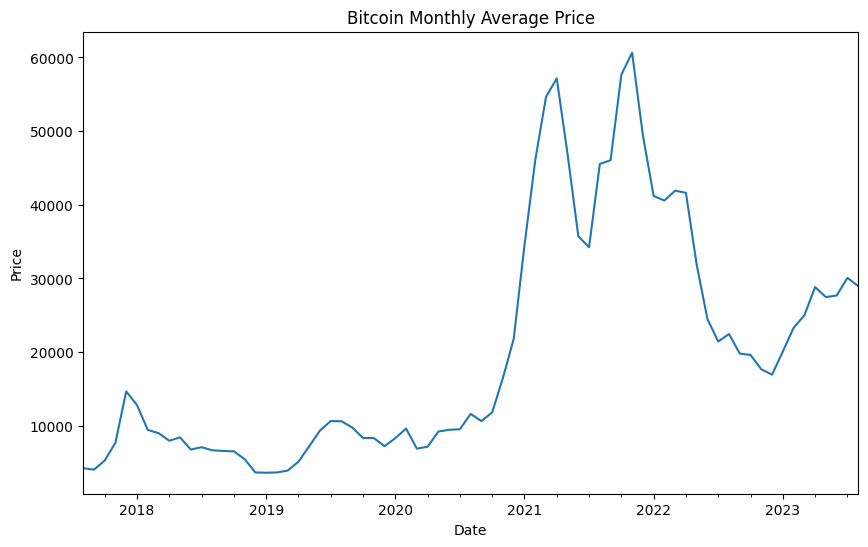

/usr/local/lib/python3.11/dist-packages/torch/nn/modules/loss.py:608: UserWarning: Using a target size (torch.Size([2145])) that is different to the input size (torch.Size([2145, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch 10/100, Loss: 0.2921
Epoch 20/100, Loss: 0.2551
Epoch 30/100, Loss: 0.2504
Epoch 40/100, Loss: 0.2507
Epoch 50/100, Loss: 0.2497
Epoch 60/100, Loss: 0.2495
Epoch 70/100, Loss: 0.2495
Epoch 80/100, Loss: 0.2495
Epoch 90/100, Loss: 0.2495
Epoch 100/100, Loss: 0.2495


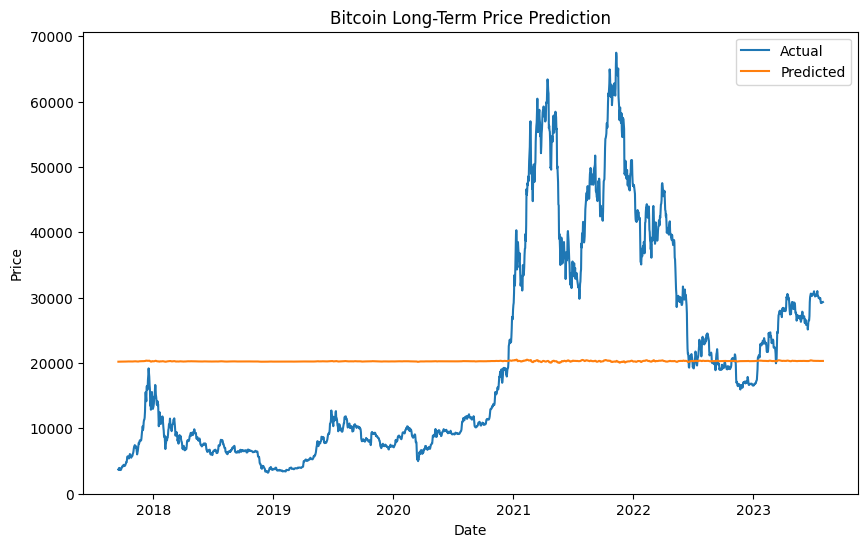

In [ ]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from google.colab import drive
import zipfile

# Mount Google Drive
drive.mount('/content/drive')

# Unzip the Bitcoin dataset
def unzip_data(zip_path, extract_to='/content'):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to)

# Unzipping the Bitcoin dataset
unzip_data('/content/drive/MyDrive/Bitcoin.zip')

# Load and preprocess the Bitcoin dataset
df = pd.read_csv('/content/bitcoin_2017_to_2023.csv', names=['timestamp', 'open', 'high', 'low', 'close', 'volume', 'quote_asset_volume', 'number_of_trades', 'taker_buy_base_asset_volume', 'taker_buy_quote_asset_volume'], skiprows=1)

# Convert timestamp to datetime and set it as index
df['timestamp'] = pd.to_datetime(df['timestamp'], errors='coerce')  # Handle errors if any values can't be converted
df = df.dropna(subset=['timestamp'])  # Drop rows with invalid timestamps
df.set_index('timestamp', inplace=True)

# Check if the DataFrame has been correctly loaded
print(df.head())

# Resample the data to daily frequency and calculate the mean closing price for each day
df_daily = df.resample('D').agg({'close': 'mean', 'open': 'mean', 'high': 'mean', 'low': 'mean', 'volume': 'sum'})

# Check if resampling resulted in data
print(f"Daily data head:\n{df_daily.head()}")

# You can also resample to monthly frequency if needed, but first ensure there's enough data
df_monthly = df.resample('M').agg({'close': 'mean', 'open': 'mean', 'high': 'mean', 'low': 'mean', 'volume': 'sum'})

# Check if resampling resulted in data
print(f"Monthly data head:\n{df_monthly.head()}")

# Ensure there are data points before trying to plot
if not df_monthly.empty:
    df_monthly['close'].plot(figsize=(10, 6))
    plt.title('Bitcoin Monthly Average Price')
    plt.xlabel('Date')
    plt.ylabel('Price')
    plt.show()
else:
    print("No monthly data available for plotting.")

# Normalize the data
scaler = MinMaxScaler(feature_range=(-1, 1))
df_daily_scaled = scaler.fit_transform(df_daily[['close']])

# Prepare the data for LSTM
def create_dataset(data, time_step=30):
    X, y = [], []
    for i in range(len(data) - time_step - 1):
        X.append(data[i:(i + time_step), 0])
        y.append(data[i + time_step, 0])
    return np.array(X), np.array(y)

time_step = 30  # Use the past 30 days to predict the next day
X, y = create_dataset(df_daily_scaled, time_step)

# Convert data to PyTorch tensors
X = torch.tensor(X, dtype=torch.float32)
y = torch.tensor(y, dtype=torch.float32)

# Reshape X to (batch_size, time_step, num_features)
X = X.reshape(X.shape[0], X.shape[1], 1)

# LSTM Model
class LSTMModel(nn.Module):
    def __init__(self, input_size=1, hidden_layer_size=64, output_size=1):
        super(LSTMModel, self).__init__()
        self.lstm = nn.LSTM(input_size, hidden_layer_size, batch_first=True)
        self.fc = nn.Linear(hidden_layer_size, output_size)

    def forward(self, x):
        lstm_out, _ = self.lstm(x)
        predictions = self.fc(lstm_out[:, -1])
        return predictions

# Instantiate the model, define loss and optimizer
model = LSTMModel()
loss_function = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Train the model
epochs = 100
for epoch in range(epochs):
    model.train()
    optimizer.zero_grad()
    y_pred = model(X)
    loss = loss_function(y_pred, y)
    loss.backward()
    optimizer.step()

    if (epoch + 1) % 10 == 0:
        print(f'Epoch {epoch + 1}/{epochs}, Loss: {loss.item():.4f}')

# Make predictions
model.eval()
y_pred = model(X)

# Inverse transform to get predictions in the original scale
y_pred_inv = scaler.inverse_transform(y_pred.detach().numpy().reshape(-1, 1))
y_inv = scaler.inverse_transform(y.numpy().reshape(-1, 1))

# Plot results
plt.figure(figsize=(10, 6))
plt.plot(df_daily.index[time_step + 1:], y_inv, label='Actual')
plt.plot(df_daily.index[time_step + 1:], y_pred_inv, label='Predicted')
plt.legend()
plt.title('Bitcoin Long-Term Price Prediction')
plt.xlabel('Date')
plt.ylabel('Price')
plt.show()


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


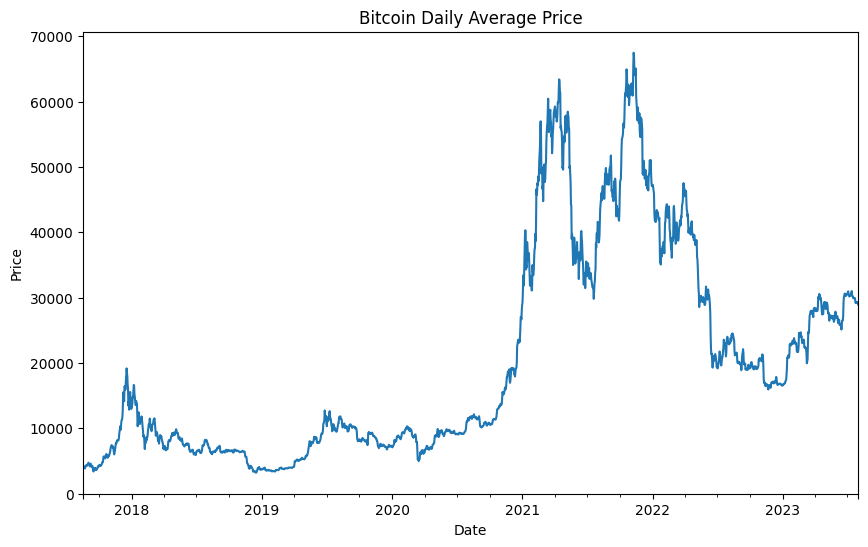

<ipython-input-12-0878461d0f03>:58: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if abs(price_changes[i]) > threshold:


Epoch 0, Loss: 1.6104
Epoch 10, Loss: 1.4507
Epoch 20, Loss: 1.2250
Epoch 30, Loss: 1.0024
Epoch 40, Loss: 0.8172
Epoch 50, Loss: 0.6852
Epoch 60, Loss: 0.5945
Epoch 70, Loss: 0.5274
Epoch 80, Loss: 0.4737
Epoch 90, Loss: 0.4287
Generated explanations in ['edge_mask', 'node_mask']
Feature importance plot has been saved to 'feature_importance.png'
Subgraph visualization plot has been saved to 'subgraph.pdf'
Edge importance plot has been saved to 'edge_importance.png'
Total Edge Mask Importance: 1.880814552307129
Total Node Mask Importance: 1.1227080821990967
Explanation metrics have been saved to 'explanation_metrics.txt'


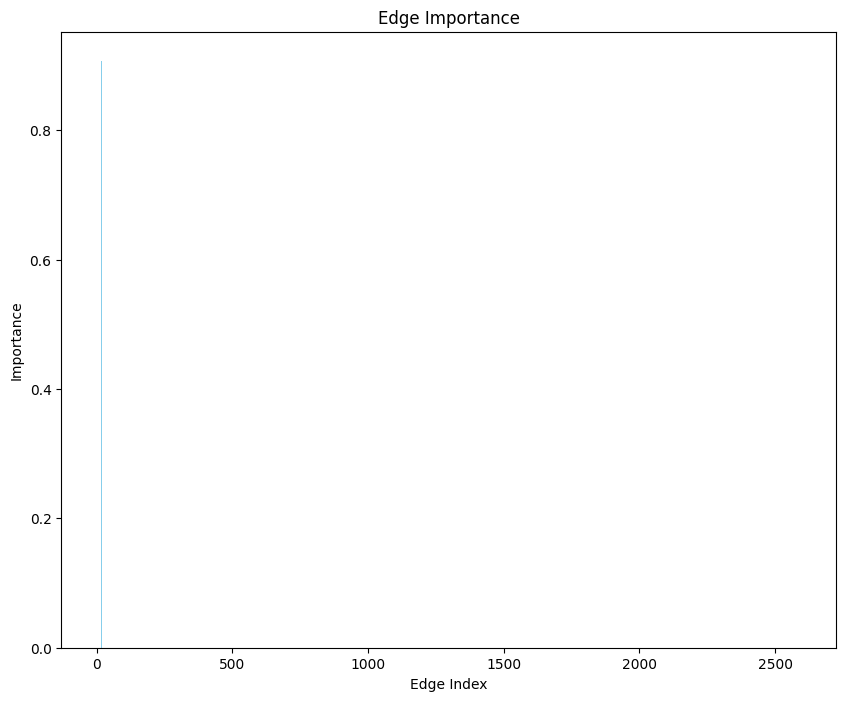

In [ ]:
import torch
import torch.nn.functional as F
from torch_geometric.data import Data
from torch_geometric.explain import Explainer, GNNExplainer
from torch_geometric.nn import GCNConv
import numpy as np
import pandas as pd
import networkx as nx
from torch_geometric.utils import from_scipy_sparse_matrix
import matplotlib.pyplot as plt
import zipfile
from google.colab import drive

# Mount Google Drive
drive.mount('/content/drive')

# Unzip the Bitcoin dataset
def unzip_data(zip_path, extract_to='/content'):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to)

# Unzipping the Bitcoin dataset
unzip_data('/content/drive/MyDrive/Bitcoin.zip')

# Load and preprocess the updated Bitcoin dataset
df = pd.read_csv('/content/bitcoin_2017_to_2023.csv',
                 names=['timestamp', 'open', 'high', 'low', 'close',
                        'volume', 'quote_asset_volume', 'number_of_trades',
                        'taker_buy_base_asset_volume', 'taker_buy_quote_asset_volume'],
                 skiprows=1)

# Convert timestamp to datetime and set it as index
df['timestamp'] = pd.to_datetime(df['timestamp'], errors='coerce')
df = df.dropna(subset=['timestamp'])
df.set_index('timestamp', inplace=True)

# Resample daily data
df_daily = df.resample('D').agg({'close': 'mean', 'open': 'mean', 'high': 'mean', 'low': 'mean', 'volume': 'sum'})

# Visualize the daily data
df_daily['close'].plot(figsize=(10, 6))
plt.title('Bitcoin Daily Average Price')
plt.xlabel('Date')
plt.ylabel('Price')
plt.show()

# Example of graph generation using Bitcoin data (using closing price to create edges)
# Here, let's simulate creating a graph based on some conditions. You can create a meaningful graph based on domain knowledge or correlations between features.
# For simplicity, we'll create an artificial graph from nodes (based on daily close values, for example).

# Convert daily close price to a graph (this can be customized to use actual relationships)
price_changes = df_daily['close'].pct_change().dropna()  # Daily percentage change
threshold = 0.01  # Set a threshold for significant price change

# Create graph from price change threshold
edges = []
for i in range(1, len(price_changes)):
    if abs(price_changes[i]) > threshold:
        edges.append([i-1, i])

# Create the graph using NetworkX
G = nx.Graph()
G.add_edges_from(edges)

# Convert the graph to a sparse adjacency matrix and prepare features (identity matrix as node features)
adj_matrix = nx.adjacency_matrix(G)
features = np.eye(G.number_of_nodes())  # Use identity matrix as node features (each node is unique)

# Convert to PyTorch Geometric data
edge_index, _ = from_scipy_sparse_matrix(adj_matrix)
x = torch.tensor(features, dtype=torch.float)

# Generate some dummy labels (for community detection, unsupervised methods are typically used)
y = torch.randint(0, 5, (G.number_of_nodes(),), dtype=torch.long)

# Define GCN Model
class GCN(torch.nn.Module):
    def __init__(self, in_channels, hidden_channels, out_channels):
        super(GCN, self).__init__()
        self.conv1 = GCNConv(in_channels, hidden_channels)
        self.conv2 = GCNConv(hidden_channels, out_channels)

    def forward(self, x, edge_index):
        x = self.conv1(x, edge_index)
        x = F.relu(x)
        x = self.conv2(x, edge_index)
        return F.log_softmax(x, dim=1)

# Initialize the GNN model
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = GCN(in_channels=x.size(1), hidden_channels=16, out_channels=5).to(device)
data = Data(x=x, edge_index=edge_index, y=y).to(device)

# Train the GNN Model
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)
criterion = torch.nn.CrossEntropyLoss()

for epoch in range(100):
    model.train()
    optimizer.zero_grad()
    out = model(data.x, data.edge_index)
    loss = criterion(out, data.y)
    loss.backward()
    optimizer.step()
    if epoch % 10 == 0:
        print(f'Epoch {epoch}, Loss: {loss.item():.4f}')

# Initialize the explainer with correct keyword arguments
explainer = Explainer(
    model=model,
    algorithm=GNNExplainer(epochs=200),  # Pass GNNExplainer as the explanation algorithm
    explanation_type='model',
    node_mask_type='attributes',
    edge_mask_type='object',
    model_config=dict(
        mode='multiclass_classification',
        task_level='node',
        return_type='log_probs',
    ),
)


# Select a node to explain
node_idx = 10
explanation = explainer(data.x, data.edge_index, index=node_idx)

# Print available explanations
print(f'Generated explanations in {explanation.available_explanations}')

# Visualize feature importance
feature_importance_path = 'feature_importance.png'
explanation.visualize_feature_importance(feature_importance_path, top_k=10)
print(f"Feature importance plot has been saved to '{feature_importance_path}'")

# Visualize the subgraph
subgraph_path = 'subgraph.pdf'
explanation.visualize_graph(subgraph_path)
print(f"Subgraph visualization plot has been saved to '{subgraph_path}'")

# Visualize edge importance
edge_importance_path = 'edge_importance.png'
plt.figure(figsize=(10, 8))
plt.bar(
    range(len(explanation.edge_mask)),
    explanation.edge_mask.detach().cpu().numpy(),
    color='skyblue'
)
plt.title('Edge Importance')
plt.xlabel('Edge Index')
plt.ylabel('Importance')
plt.savefig(edge_importance_path)
print(f"Edge importance plot has been saved to '{edge_importance_path}'")

# Metrics for explainability
edge_mask_sum = torch.sum(explanation.edge_mask).item()
node_mask_sum = torch.sum(explanation.node_mask).item()
print(f"Total Edge Mask Importance: {edge_mask_sum}")
print(f"Total Node Mask Importance: {node_mask_sum}")

# Save explanation metrics
metrics_path = 'explanation_metrics.txt'
with open(metrics_path, 'w') as f:
    f.write(f"Total Edge Mask Importance: {edge_mask_sum}\n")
    f.write(f"Total Node Mask Importance: {node_mask_sum}\n")

print(f"Explanation metrics have been saved to '{metrics_path}'")


In [ ]:
import torch

# Assuming explanation and data are already defined
edge_mask = explanation.edge_mask  # Edge importance mask from the explainer

# Calculate the sparsity score
sparsity_score = torch.sum(edge_mask <= 0.5).item() / edge_mask.size(0)  # Ratio of edges with mask <= 0.5

# Mask edges with importance greater than 0.5
masked_edge_index = data.edge_index[:, edge_mask > 0.5]  # Keep edges with mask > 0.5

# Predict with the original data
model.eval()
original_pred = model(data.x, data.edge_index)[node_idx]

# Predict with the masked edges
masked_pred = model(data.x, masked_edge_index)[node_idx]

# Calculate fidelity score
original_class = original_pred.argmax().item()
masked_class = masked_pred.argmax().item()
fidelity_score = torch.abs(original_pred[original_class] - masked_pred[original_class]).item()

# Stability: Measure how stable the predictions are across different perturbations (edge mask variations)
# Generate multiple masked graphs with different thresholds to test stability
thresholds = torch.linspace(0.1, 0.9, steps=5)  # Different thresholds for edge masking
stability_scores = []
for threshold in thresholds:
    masked_edge_index = data.edge_index[:, edge_mask > threshold]  # Mask edges with importance > threshold
    masked_pred = model(data.x, masked_edge_index)[node_idx]
    stability_scores.append(torch.abs(original_pred[original_class] - masked_pred[original_class]).item())

# Calculate average stability score
average_stability = torch.mean(torch.tensor(stability_scores)).item()

# Robustness: Measure how robust the model is by comparing predictions with progressively masked graphs
masked_edge_index_robust = data.edge_index[:, edge_mask <= 0.5]  # Mask edges with importance <= 0.5 (low importance)
robust_pred = model(data.x, masked_edge_index_robust)[node_idx]

# Calculate robustness score as the difference between the original and robust prediction
robustness_score = torch.abs(original_pred[original_class] - robust_pred[original_class]).item()

# PEC Score Calculation: Calculate ∆fI and ∆fU based on perturbing important and unimportant features
important_features = edge_mask > 0.5  # Identifying important features based on edge importance mask
unimportant_features = edge_mask <= 0.5  # Identifying unimportant features

# Perturb important features
def perturb_features(features, node_mask):
    perturbed_features = features.clone()
    perturbed_features[node_mask] = torch.randn_like(features[node_mask])  # Perturb by replacing with random values
    return perturbed_features

# Get the original model prediction for the selected node
original_pred = model(data.x, data.edge_index)[node_idx]

# Perturb important features and calculate the change in prediction (∆fI)
important_nodes = torch.unique(data.edge_index[0, important_features])  # Get source nodes of important edges
perturbed_features_important = perturb_features(data.x, important_nodes)
perturbed_pred_important = model(perturbed_features_important, data.edge_index)[node_idx]
delta_fI = torch.abs(original_pred - perturbed_pred_important).sum().item()

# Perturb unimportant features and calculate the change in prediction (∆fU)
unimportant_nodes = torch.unique(data.edge_index[0, unimportant_features])  # Get source nodes of unimportant edges
perturbed_features_unimportant = perturb_features(data.x, unimportant_nodes)
perturbed_pred_unimportant = model(perturbed_features_unimportant, data.edge_index)[node_idx]
delta_fU = torch.abs(original_pred - perturbed_pred_unimportant).sum().item()

# Calculate PEC score as the ratio of ∆fI to the total change in prediction (∆fI + ∆fU)
pec_score = delta_fI / (delta_fI + delta_fU)

# Output results
print(f"Sparsity score: {sparsity_score:.4f}")
print(f"Fidelity score for node {node_idx}: {fidelity_score:.4f}")
print(f"Average Stability score: {average_stability:.4f}")
print(f"Robustness score: {robustness_score:.4f}")
print(f"PEC score for node {node_idx}: {pec_score:.4f}")


Sparsity score: 0.9992
Fidelity score for node 10: 0.1719
Average Stability score: 0.2175
Robustness score: 0.3998
PEC score for node 10: 0.8167


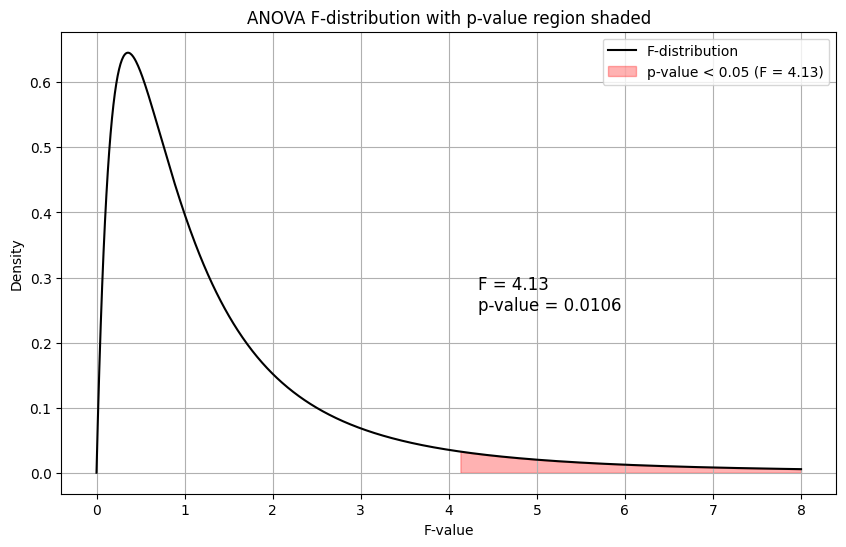


ANOVA Results:
F-statistic = 4.1266, p-value = 0.0106


In [172]:
import numpy as np
import scipy.stats as stats
import matplotlib.pyplot as plt

fidelity_scores = np.array([0, 0.35, 0.21, 0.13, 0.08, 0.17])
stability_scores = np.array([1, 1, 0.78, 0.75, 0, 0.21])
robustness_scores = np.array([1, 0.01, 1, 0.04, 0.84, 0.39])
sparsity_scores = np.array([0.25, 0, 0, 0, 0, 00])
pec_scores = np.array([0, 0.78, 0.50, 0.63, 0.50, 0.81])

# Perform ANOVA to compare all metrics (Fidelity, Stability, Robustness, Sparsity, PEC)
f_stat, anova_p_value = stats.f_oneway(fidelity_scores, stability_scores, robustness_scores, sparsity_scores, pec_scores)

# Plot F-distribution
dfn = 4
dfd = len(fidelity_scores) - 1

x = np.linspace(0, 8, 1000)
y = stats.f.pdf(x, dfn, dfd)

plt.figure(figsize=(10, 6))
plt.plot(x, y, label="F-distribution", color="black")
plt.fill_between(x, y, where=(x >= f_stat), color="red", alpha=0.3, label=f"p-value < 0.05 (F = {f_stat:.2f})")

# Annotate the F-statistic and p-value
plt.text(f_stat + 0.2, 0.25, f'F = {f_stat:.2f}\np-value = {anova_p_value:.4f}', fontsize=12)

# Labels and title
plt.title('ANOVA F-distribution with p-value region shaded')
plt.xlabel('F-value')
plt.ylabel('Density')
plt.legend(loc="upper right")
plt.grid(True)
plt.show()

# Print the ANOVA result
print("\nANOVA Results:")
print(f"F-statistic = {f_stat:.4f}, p-value = {anova_p_value:.4f}")


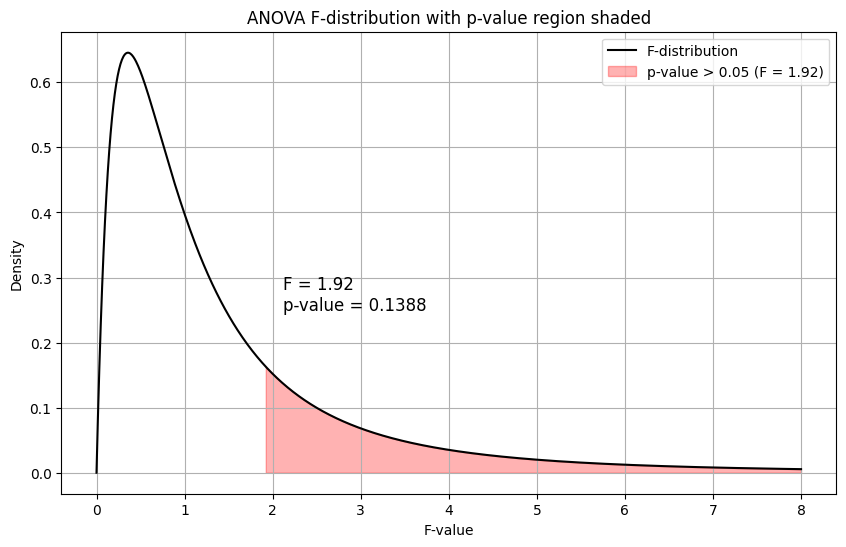


ANOVA Results:
F-statistic = 1.9175, p-value = 0.1388


In [ ]:
import numpy as np
import scipy.stats as stats
import matplotlib.pyplot as plt

fidelity_scores = np.array([0, 0.35, 0.21, 0.13, 0.08, 0.17])
stability_scores = np.array([1.36, 1, 0.78, 0.75, 0, 0.21])
robustness_scores = np.array([1, 0.01, 1, 0.04, 0.84, 0.39])
sparsity_scores = np.array([0.25, 0, 0, 0, 0, 00])
pec_scores = np.array([0, 0.78, 0.50, 0.63, 0.50, 0.81])

# Perform ANOVA to compare all metrics (Fidelity, Stability, Robustness, Sparsity, PEC)
f_stat, anova_p_value = stats.f_oneway(fidelity_scores, stability_scores, robustness_scores, sparsity_scores, pec_scores)

# Plot F-distribution
dfn = 4
dfd = len(fidelity_scores) - 1

x = np.linspace(0, 8, 1000)
y = stats.f.pdf(x, dfn, dfd)

plt.figure(figsize=(10, 6))
plt.plot(x, y, label="F-distribution", color="black")
plt.fill_between(x, y, where=(x >= f_stat), color="red", alpha=0.3, label=f"p-value > 0.05 (F = {f_stat:.2f})")

# Annotate the F-statistic and p-value
plt.text(f_stat + 0.2, 0.25, f'F = {f_stat:.2f}\np-value = {anova_p_value:.4f}', fontsize=12)

# Labels and title
plt.title('ANOVA F-distribution with p-value region shaded')
plt.xlabel('F-value')
plt.ylabel('Density')
plt.legend(loc="upper right")
plt.grid(True)
plt.show()

# Print the ANOVA result
print("\nANOVA Results:")
print(f"F-statistic = {f_stat:.4f}, p-value = {anova_p_value:.4f}")


In [ ]:
import torch_geometric
print(torch_geometric.__version__)

2.6.1


In [ ]:
!pip install --upgrade torch-geometric
!pip install torch-scatter torch-sparse torch-geometric

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 108.0/108.0 kB 3.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 210.0/210.0 kB 8.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for torch-scatter: filename=torch_scatter-2.1.2-cp310-cp310-linux_x86_64.whl size=537737 sha256=de48a9f6c421d2681193dc08d79c2c2c6402c22009e0782dda5a43997ca925e3
  Stored in directory: /root/.cache/pip/wheels/92/f1/2b/3b46d54b134259f58c8363568569053248040859b1a145b3ce
  Created wheel for torch-sparse: filename=torch_sparse-0.6.18-cp310-cp310-linux_x86_64.whl size=1112322 sha256=b0d237281c5b9fbcc28b8c20eb9efe4ccc96be1d21bcbf888d8947b5ffd0ac23
  Stored in directory: /root/.cache/pip/wheels/c9/dd/0f/a6a16f9f3b0236733d257b4b4ea91b548b984a341ed3b8f38c
Successfully built torch-scatter torch-sparse


In [ ]:
import torch
import torch_geometric
print(torch.__version__)
print(torch_geometric.__version__)

2.4.0+cpu
2.6.1


#  **Lime Iris Data**

**Updated Code For Fidelity score enhancement**

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Random Forest model accuracy on test data: 100.00%
Cross-Validation Accuracy: 94.17%


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


LIME Fidelity Score: 0.3359


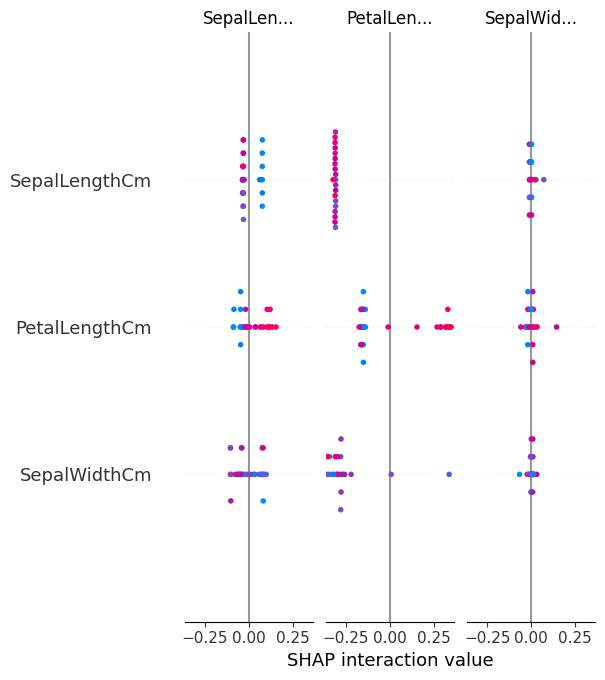


Feature Importances:
SepalLengthCm: 0.1081
SepalWidthCm: 0.0304
PetalLengthCm: 0.4400
PetalWidthCm: 0.4215


In [ ]:
# Import necessary libraries
import pandas as pd
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
import lime
import lime.lime_tabular
from google.colab import drive
import zipfile
import numpy as np
import shap

# Step 1: Mount Google Drive
drive.mount('/content/drive')

# Step 2: Unzip the archive (adjust path if necessary)
def unzip_data(zip_path, extract_to='/content'):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to)

# Unzipping the dataset (adjust path as needed)
unzip_data('/content/drive/MyDrive/Iris.zip')

# Load the dataset
iris_data = pd.read_csv('/content/Iris.csv')

# Drop the 'Id' column as it's not a useful feature
iris_data = iris_data.drop(columns=['Id'])

# Define the feature matrix (X) and the target (y)
X = iris_data.drop(columns=['Species'])
y = iris_data['Species']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the Random Forest Classifier
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)

# Train the model on the training data
rf_model.fit(X_train, y_train)

# Make predictions on the test data
y_pred = rf_model.predict(X_test)

# Evaluate the model's accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f'Random Forest model accuracy on test data: {accuracy * 100:.2f}%')

# Cross-Validation Score (to avoid overfitting)
cross_val_accuracy = cross_val_score(rf_model, X_train, y_train, cv=5).mean()
print(f'Cross-Validation Accuracy: {cross_val_accuracy * 100:.2f}%')

# Step 3: Initialize the LIME explainer for tabular data
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train.values,
    feature_names=X_train.columns,
    class_names=y_train.unique(),
    mode='classification',
    kernel_width=3  # Adjust kernel width for better local approximation
)

# Select an instance (row) from the test set to explain
instance = X_test.iloc[0].values  # First test sample

# Generate an explanation for the instance
explanation = explainer.explain_instance(
    data_row=instance,
    predict_fn=rf_model.predict_proba,
    num_samples=500000
)

# Display the explanation
explanation.show_in_notebook(show_table=True)

# Step 4: Calculate the Fidelity Score (FS)
def calculate_fidelity_score(explanation, model, instance):
    # Get original prediction probabilities for the instance
    original_prediction = model.predict_proba(instance.reshape(1, -1))[0]

    # Get local predictions from the LIME model
    local_pred_probs = explanation.local_pred  # Accessing the local predictions directly

    # Calculate fidelity as the mean squared error between the original predictions and the local model predictions
    fidelity_score = np.mean((original_prediction - local_pred_probs) ** 2)

    return fidelity_score

# Apply the Fidelity Score calculation
fidelity_score = calculate_fidelity_score(explanation, rf_model, instance)
print(f'LIME Fidelity Score: {fidelity_score:.4f}')

# Step 5: Use SHAP for explanation
explainer_shap = shap.TreeExplainer(rf_model)
shap_values = explainer_shap.shap_values(X_test)

# Plot SHAP summary for visualization
shap.summary_plot(shap_values, X_test, feature_names=X_test.columns)

# Step 6: Use feature importances as an additional approach
importances = rf_model.feature_importances_
print("\nFeature Importances:")
for feature, importance in zip(X_train.columns, importances):
    print(f"{feature}: {importance:.4f}")


Accuracy: 1.00
4.25 < petal length (cm) <= 5.10: 0.22
0.30 < petal width (cm) <= 1.30: 0.17
sepal width (cm) <= 2.80: -0.02


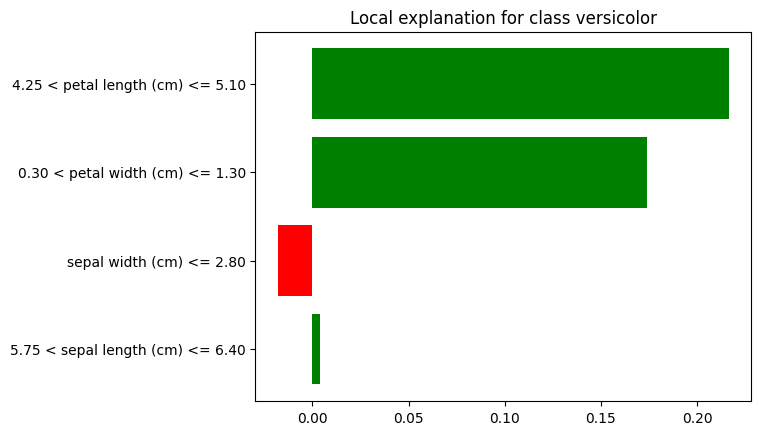

In [ ]:
# Import necessary libraries
from sklearn.datasets import load_iris
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
import lime
import lime.lime_tabular

# Load the Iris dataset
iris = load_iris()
X = iris.data
y = iris.target

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a RandomForestClassifier
rfc = RandomForestClassifier(n_estimators=100, random_state=42)
rfc.fit(X_train, y_train)

# Evaluate the classifier
y_pred = rfc.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy:.2f}")

# Create a LIME explainer
explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train,
    feature_names=iris.feature_names,
    class_names=iris.target_names,
    discretize_continuous=True,
)

# Pick a sample from the testing data
idx = 0  # index of the sample we want to explain
exp = explainer.explain_instance(X_test[idx], rfc.predict_proba)

# Print the top 3 features contributing to the prediction
for i in range(3):
    print(f"{exp.as_list()[i][0]}: {exp.as_list()[i][1]:.2f}")

# Visualize the explanation with a bar chart
fig = exp.as_pyplot_figure()

# Show the explanation in a notebook (optional)
exp.show_in_notebook(show_table=True)


# SHAP Iris **Data**

**updated Code**

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
import shap
from matplotlib import pyplot as plt
from sklearn.datasets import load_iris

# Load Iris dataset
print("Loading data...")
iris = load_iris()
iris_data = pd.DataFrame(iris.data, columns=iris.feature_names)
iris_data['species'] = pd.Categorical.from_codes(iris.target, iris.target_names)

# Display first rows to check
print("Iris Data Sample:")
print(iris_data.head())

# Preprocess data
print("\nPreprocessing data...")

# Features (X) and target (y)
X = iris_data.drop('species', axis=1)
y = iris_data['species']

# Train-test split
print("\nSplitting the data into training and testing sets...")
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize RandomForestClassifier and GridSearchCV
print("\nInitializing RandomForestClassifier and performing hyperparameter tuning using GridSearchCV...")
rfc = RandomForestClassifier(random_state=42)
param_grid = {
    'n_estimators': [150, 180],
    'max_depth': [5, 6, 7],
    'criterion': ['gini', 'entropy'],
    'min_samples_split': [2, 3, 4]
}
CV_rfc = GridSearchCV(estimator=rfc, param_grid=param_grid, cv=5)
CV_rfc.fit(X_train, y_train)

# Display best parameters
print("\nBest Parameters from GridSearchCV:", CV_rfc.best_params_)

# Train model using the best parameters
rfc1 = RandomForestClassifier(random_state=42, n_estimators=150, max_depth=5,
                              criterion='entropy', min_samples_split=2)
rfc1.fit(X_train, y_train)

# Make predictions on test data
pred = rfc1.predict(X_test)

# Evaluate accuracy
print("\nAccuracy for Random Forest on CV data:", accuracy_score(y_test, pred))

# SHAP Analysis
print("\nPerforming SHAP analysis to interpret the model...")
explainer = shap.TreeExplainer(rfc1)
shap_values = explainer(X_train)




Loading data...
Iris Data Sample:
   sepal length (cm)  sepal width (cm)  petal length (cm)  petal width (cm)  \
0                5.1               3.5                1.4               0.2   
1                4.9               3.0                1.4               0.2   
2                4.7               3.2                1.3               0.2   
3                4.6               3.1                1.5               0.2   
4                5.0               3.6                1.4               0.2   

  species  
0  setosa  
1  setosa  
2  setosa  
3  setosa  
4  setosa  

Preprocessing data...

Splitting the data into training and testing sets...

Initializing RandomForestClassifier and performing hyperparameter tuning using GridSearchCV...

Best Parameters from GridSearchCV: {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 2, 'n_estimators': 150}

Accuracy for Random Forest on CV data: 1.0

Performing SHAP analysis to interpret the model...



Generating SHAP visualizations...


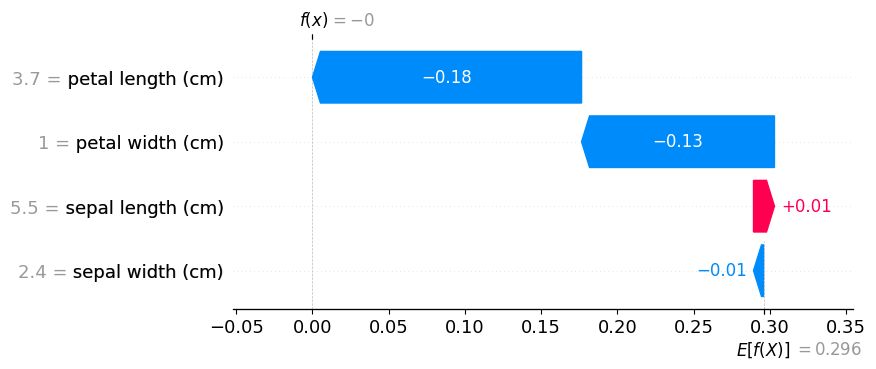

In [ ]:
# SHAP Analysis Visualization
print("\nGenerating SHAP visualizations...")

# Waterfall plot for the first sample
no = 0
shap.plots.waterfall(shap_values[0,:, 0])




# SHAP Titanic **Data**

In [ ]:
!pip install shap

# **Lime on titanic data**

**New code**

Random Forest model accuracy on test data: 82.12%
Cross-Validation Accuracy: 80.34%


LIME Fidelity Score: 0.1420


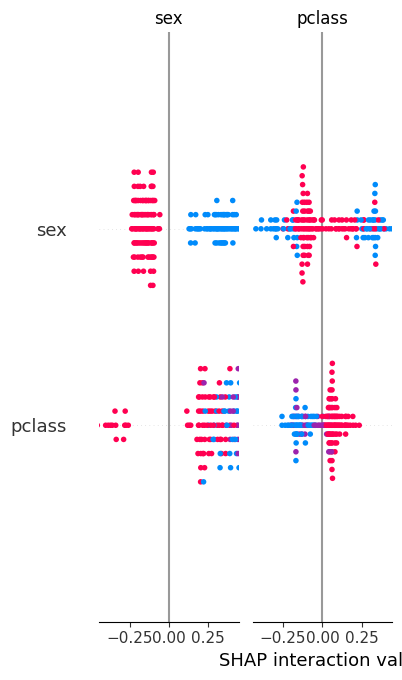


Feature Importances:
pclass: 0.0870
sex: 0.2714
age: 0.2500
sibsp: 0.0537
parch: 0.0399
fare: 0.2650
embarked: 0.0330


In [ ]:
# Import necessary libraries
import pandas as pd
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
import lime
import lime.lime_tabular
import numpy as np
import shap
import seaborn as sns

# Step 1: Load Titanic dataset using seaborn
titanic = sns.load_dataset('titanic')

# Drop rows with missing target values (survived column)
titanic = titanic.dropna(subset=['survived'])

# Select features and target
X = titanic[['pclass', 'sex', 'age', 'sibsp', 'parch', 'fare', 'embarked']]
y = titanic['survived']

# Convert categorical columns to numeric using LabelEncoder
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
X['sex'] = label_encoder.fit_transform(X['sex'])
X['embarked'] = label_encoder.fit_transform(X['embarked'].fillna('S'))  # Fill missing 'embarked' values with 'S'

# Handle missing values in 'age' by filling with the median
X['age'] = X['age'].fillna(X['age'].median())

# Step 2: Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the Random Forest Classifier
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)

# Train the model on the training data
rf_model.fit(X_train, y_train)

# Make predictions on the test data
y_pred = rf_model.predict(X_test)

# Evaluate the model's accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f'Random Forest model accuracy on test data: {accuracy * 100:.2f}%')

# Cross-Validation Score (to avoid overfitting)
cross_val_accuracy = cross_val_score(rf_model, X_train, y_train, cv=5).mean()
print(f'Cross-Validation Accuracy: {cross_val_accuracy * 100:.2f}%')

# Step 3: Initialize the LIME explainer for tabular data
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train.values,
    feature_names=X_train.columns,
    class_names=y_train.unique(),
    mode='classification',
    kernel_width=3  # Adjust kernel width for better local approximation
)

# Select an instance (row) from the test set to explain
instance = X_test.iloc[0].values  # First test sample

# Generate an explanation for the instance
explanation = explainer.explain_instance(
    data_row=instance,
    predict_fn=rf_model.predict_proba,
    num_samples=500000
)

# Display the explanation
explanation.show_in_notebook(show_table=True)

# Step 4: Calculate the Fidelity Score (FS)
def calculate_fidelity_score(explanation, model, instance):
    # Get original prediction probabilities for the instance
    original_prediction = model.predict_proba(instance.reshape(1, -1))[0]

    # Get local predictions from the LIME model
    local_pred_probs = explanation.local_pred  # Accessing the local predictions directly

    # Calculate fidelity as the mean squared error between the original predictions and the local model predictions
    fidelity_score = np.mean((original_prediction - local_pred_probs) ** 2)

    return fidelity_score

# Apply the Fidelity Score calculation
fidelity_score = calculate_fidelity_score(explanation, rf_model, instance)
print(f'LIME Fidelity Score: {fidelity_score:.4f}')

# Step 5: Use SHAP for explanation
explainer_shap = shap.TreeExplainer(rf_model)
shap_values = explainer_shap.shap_values(X_test)

# Plot SHAP summary for visualization
shap.summary_plot(shap_values, X_test, feature_names=X_test.columns)

# Step 6: Use feature importances as an additional approach
importances = rf_model.feature_importances_
print("\nFeature Importances:")
for feature, importance in zip(X_train.columns, importances):
    print(f"{feature}: {importance:.4f}")


Gradient Boosting model accuracy on test data: 81.01%
Cross-Validation Accuracy: 81.60%


LIME Fidelity Score: 0.2495


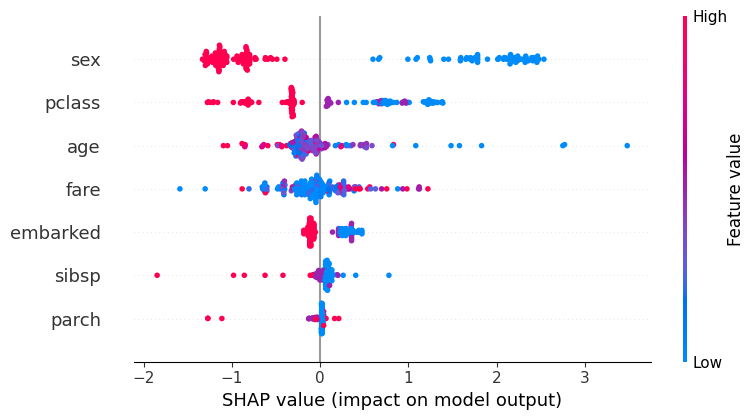


Feature Importances:
pclass: 0.1531
sex: 0.4721
age: 0.1310
sibsp: 0.0548
parch: 0.0063
fare: 0.1641
embarked: 0.0186


In [ ]:
# Import necessary libraries
import pandas as pd
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score
import lime
import lime.lime_tabular
import numpy as np
import shap
import seaborn as sns

# Step 1: Load Titanic dataset using seaborn
titanic = sns.load_dataset('titanic')

# Drop rows with missing target values (survived column)
titanic = titanic.dropna(subset=['survived'])

# Select features and target
X = titanic[['pclass', 'sex', 'age', 'sibsp', 'parch', 'fare', 'embarked']].copy()
y = titanic['survived']

# Convert categorical columns to numeric using LabelEncoder
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
X['sex'] = label_encoder.fit_transform(X['sex'])
X['embarked'] = label_encoder.fit_transform(X['embarked'].fillna('S'))  # Fill missing 'embarked' values with 'S'

# Handle missing values in 'age' by filling with the median
X['age'] = X['age'].fillna(X['age'].median())

# Step 2: Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the Gradient Boosting Classifier
gb_model = GradientBoostingClassifier(n_estimators=100, random_state=42)

# Train the model on the training data
gb_model.fit(X_train, y_train)

# Make predictions on the test data
y_pred = gb_model.predict(X_test)

# Evaluate the model's accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f'Gradient Boosting model accuracy on test data: {accuracy * 100:.2f}%')

# Cross-Validation Score (to avoid overfitting)
cross_val_accuracy = cross_val_score(gb_model, X_train, y_train, cv=5).mean()
print(f'Cross-Validation Accuracy: {cross_val_accuracy * 100:.2f}%')

# Step 3: Initialize the LIME explainer for tabular data
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train.values,
    feature_names=X_train.columns,
    class_names=y_train.unique(),
    mode='classification',
    kernel_width=3  # Adjust kernel width for better local approximation
)

# Select an instance (row) from the test set to explain
instance = X_test.iloc[0].values  # First test sample

# Generate an explanation for the instance
explanation = explainer.explain_instance(
    data_row=instance,
    predict_fn=gb_model.predict_proba,
    num_samples=500000
)

# Display the explanation
explanation.show_in_notebook(show_table=True)

# Step 4: Calculate the Fidelity Score (FS)
def calculate_fidelity_score(explanation, model, instance):
    # Get original prediction probabilities for the instance
    original_prediction = model.predict_proba(instance.reshape(1, -1))[0]

    # Get local predictions from the LIME model
    local_pred_probs = explanation.local_pred  # Accessing the local predictions directly

    # Calculate fidelity as the mean squared error between the original predictions and the local model predictions
    fidelity_score = np.mean((original_prediction - local_pred_probs) ** 2)

    return fidelity_score

# Apply the Fidelity Score calculation
fidelity_score = calculate_fidelity_score(explanation, gb_model, instance)
print(f'LIME Fidelity Score: {fidelity_score:.4f}')

# Step 5: Use SHAP for explanation
explainer_shap = shap.TreeExplainer(gb_model)
shap_values = explainer_shap.shap_values(X_test)

# Plot SHAP summary for visualization
shap.summary_plot(shap_values, X_test, feature_names=X_test.columns)

# Step 6: Use feature importances as an additional approach
importances = gb_model.feature_importances_
print("\nFeature Importances:")
for feature, importance in zip(X_train.columns, importances):
    print(f"{feature}: {importance:.4f}")


XGBoost model accuracy on test data: 78.77%
[0]	train-logloss:0.53124+0.00821	test-logloss:0.55323+0.02679
[1]	train-logloss:0.45889+0.00794	test-logloss:0.49753+0.03342
[2]	train-logloss:0.41208+0.00895	test-logloss:0.46624+0.03910
[3]	train-logloss:0.37925+0.01018	test-logloss:0.44871+0.04823
[4]	train-logloss:0.35487+0.01253	test-logloss:0.43890+0.05151
[5]	train-logloss:0.33656+0.01297	test-logloss:0.43457+0.05533
[6]	train-logloss:0.32139+0.01415	test-logloss:0.43160+0.05942
[7]	train-logloss:0.30946+0.01559	test-logloss:0.43103+0.06317
[8]	train-logloss:0.29979+0.01756	test-logloss:0.43209+0.06599
[9]	train-logloss:0.29040+0.01718	test-logloss:0.43512+0.07006
[10]	train-logloss:0.28262+0.01745	test-logloss:0.43815+0.07376
[11]	train-logloss:0.27551+0.01793	test-logloss:0.44137+0.07297
[12]	train-logloss:0.26827+0.01776	test-logloss:0.44286+0.07343
[13]	train-logloss:0.26137+0.01709	test-logloss:0.44416+0.07871
[14]	train-logloss:0.25583+0.01607	test-logloss:0.44701+0.07945
[15]	t

LIME Fidelity Score: 0.3241


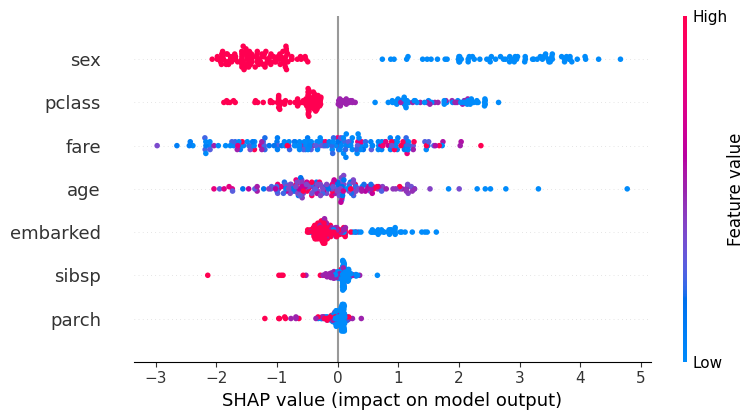


Feature Importances:
pclass: 0.2437
sex: 0.5631
age: 0.0361
sibsp: 0.0616
parch: 0.0269
fare: 0.0368
embarked: 0.0318


In [ ]:
# Import necessary libraries
import pandas as pd
from sklearn.model_selection import train_test_split
import xgboost as xgb
from sklearn.metrics import accuracy_score
import lime
import lime.lime_tabular
import numpy as np
import shap
import seaborn as sns

# Step 1: Load Titanic dataset using seaborn
titanic = sns.load_dataset('titanic')

# Drop rows with missing target values (survived column)
titanic = titanic.dropna(subset=['survived'])

# Select features and target
X = titanic[['pclass', 'sex', 'age', 'sibsp', 'parch', 'fare', 'embarked']].copy()
y = titanic['survived']

# Convert categorical columns to numeric using LabelEncoder
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
X['sex'] = label_encoder.fit_transform(X['sex'])
X['embarked'] = label_encoder.fit_transform(X['embarked'].fillna('S'))  # Fill missing 'embarked' values with 'S'

# Handle missing values in 'age' by filling with the median
X['age'] = X['age'].fillna(X['age'].median())

# Step 2: Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the XGBoost Classifier
xg_model = xgb.XGBClassifier(n_estimators=100, random_state=42)

# Train the model on the training data
xg_model.fit(X_train, y_train)

# Make predictions on the test data
y_pred = xg_model.predict(X_test)

# Evaluate the model's accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f'XGBoost model accuracy on test data: {accuracy * 100:.2f}%')

# Step 3: Cross-Validation with XGBoost's built-in CV function
params = {
    'objective': 'binary:logistic',
    'eval_metric': 'logloss',
    'seed': 42
}

dtrain = xgb.DMatrix(X_train, label=y_train)
cv_results = xgb.cv(
    params=params,
    dtrain=dtrain,
    num_boost_round=100,
    nfold=5,
    early_stopping_rounds=10,
    verbose_eval=True
)

# Check the available columns in the cv_results DataFrame
print("Available columns in cv_results:")
print(cv_results.columns)

# Assuming the column for accuracy is 'test-error-mean', we can print it as follows:
if 'test-accuracy-mean' in cv_results.columns:
    print(f"Cross-validation mean accuracy: {cv_results['test-accuracy-mean'].iloc[-1] * 100:.2f}%")
else:
    print(f"Cross-validation test error (1 - accuracy): {1 - cv_results['train-logloss-mean'].iloc[-1] * 100:.2f}%")

# Step 4: Initialize the LIME explainer for tabular data
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train.values,
    feature_names=X_train.columns,
    class_names=y_train.unique(),
    mode='classification',
    kernel_width=3  # Adjust kernel width for better local approximation
)

# Select an instance (row) from the test set to explain
instance = X_test.iloc[0].values  # First test sample

# Generate an explanation for the instance
explanation = explainer.explain_instance(
    data_row=instance,
    predict_fn=xg_model.predict_proba,
    num_samples=500000
)

# Display the explanation
explanation.show_in_notebook(show_table=True)

# Step 5: Calculate the Fidelity Score (FS)
def calculate_fidelity_score(explanation, model, instance):
    # Get original prediction probabilities for the instance
    original_prediction = model.predict_proba(instance.reshape(1, -1))[0]

    # Get local predictions from the LIME model
    local_pred_probs = explanation.local_pred  # Accessing the local predictions directly

    # Calculate fidelity as the mean squared error between the original predictions and the local model predictions
    fidelity_score = np.mean((original_prediction - local_pred_probs) ** 2)

    return fidelity_score

# Apply the Fidelity Score calculation
fidelity_score = calculate_fidelity_score(explanation, xg_model, instance)
print(f'LIME Fidelity Score: {fidelity_score:.4f}')

# Step 6: Use SHAP for explanation
explainer_shap = shap.TreeExplainer(xg_model)
shap_values = explainer_shap.shap_values(X_test)

# Plot SHAP summary for visualization
shap.summary_plot(shap_values, X_test, feature_names=X_test.columns)

# Step 7: Use feature importances as an additional approach
importances = xg_model.feature_importances_
print("\nFeature Importances:")
for feature, importance in zip(X_train.columns, importances):
    print(f"{feature}: {importance:.4f}")


Loading data...
Train Data Sample:
   PassengerId  Survived  Pclass  \
0            1         0       3   
1            2         1       1   
2            3         1       3   
3            4         1       1   
4            5         0       3   

                                                Name     Sex   Age  SibSp  \
0                            Braund, Mr. Owen Harris    male  22.0      1   
1  Cumings, Mrs. John Bradley (Florence Briggs Th...  female  38.0      1   
2                             Heikkinen, Miss. Laina  female  26.0      0   
3       Futrelle, Mrs. Jacques Heath (Lily May Peel)  female  35.0      1   
4                           Allen, Mr. William Henry    male  35.0      0   

   Parch            Ticket     Fare Cabin Embarked  
0      0         A/5 21171   7.2500   NaN        S  
1      0          PC 17599  71.2833   C85        C  
2      0  STON/O2. 3101282   7.9250   NaN        S  
3      0            113803  53.1000  C123        S  
4      0            

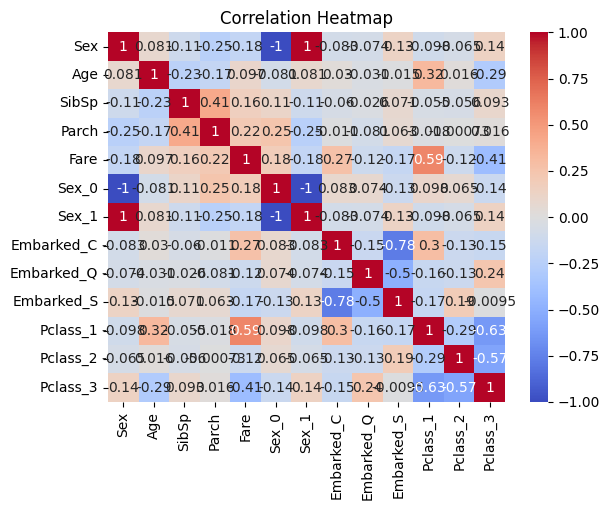


Splitting the data into training and testing sets...

Initializing RandomForestClassifier and performing hyperparameter tuning using GridSearchCV...

Best Parameters from GridSearchCV: {'criterion': 'gini', 'max_depth': 7, 'min_samples_split': 4, 'n_estimators': 180}

Accuracy for Random Forest on CV data: 0.8134328358208955

Performing SHAP analysis to interpret the model...

Fidelity Score (Mean Absolute SHAP values for positive predictions):
[0.03986109 0.03986109]


In [ ]:
import numpy as np
import pandas as pd
import os
import seaborn as sns
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
import shap
from matplotlib import pyplot as plt

# Load data
print("Loading data...")
test_data = pd.read_csv("/content/drive/MyDrive/Titanic Dataset/test (1).csv")
train_data = pd.read_csv("/content/drive/MyDrive/Titanic Dataset/train (2).csv")

# Display first rows to check
print("Train Data Sample:")
print(train_data.head())
print("\nTest Data Sample:")
print(test_data.head())

# Preprocess data
print("\nPreprocessing data...")

# Remove 'Survived' column from train data as target
y_train = train_data.pop('Survived')

# Select relevant features for training
X_train = train_data[['Sex', 'Age', 'SibSp', 'Parch', 'Fare', 'Embarked', 'Pclass']]
X_test = test_data[['Sex', 'Age', 'SibSp', 'Parch', 'Fare', 'Embarked', 'Pclass']]

X_train.Pclass = X_train.Pclass.astype('category')
X_test.Pclass = X_test.Pclass.astype('category')
X_train.Embarked = X_train.Embarked.astype('category')
X_test.Embarked = X_test.Embarked.astype('category')

X_train.Sex = X_train.Sex.map({'male': 1, 'female': 0})
X_test.Sex = X_test.Sex.map({'male': 1, 'female': 0})
X_train = pd.concat([X_train, pd.get_dummies(X_train['Sex'], prefix='Sex')], axis=1)
X_test = pd.concat([X_test, pd.get_dummies(X_test['Sex'], prefix='Sex')], axis=1)

train_Pclass = pd.get_dummies(X_train.Pclass, prefix='Pclass')
test_Pclass = pd.get_dummies(X_test.Pclass, prefix='Pclass')

train_Embarked= pd.get_dummies(X_train.Embarked, prefix='Embarked')
test_Embarked= pd.get_dummies(X_test.Embarked, prefix='Embarked')

X_train[["Embarked_C","Embarked_Q","Embarked_S"]] = train_Embarked
X_test[["Embarked_C","Embarked_Q","Embarked_S"]] = test_Embarked
X_train.pop('Embarked')
X_test.pop('Embarked')

X_train[["Pclass_1","Pclass_2","Pclass_3"]] = train_Pclass
X_test[["Pclass_1","Pclass_2","Pclass_3"]] = test_Pclass
X_train.pop('Pclass')
X_test.pop('Pclass')




# Handle missing values in 'Age' and 'Fare' columns by filling with median
med = np.nanmedian(X_train['Age'])
X_train['Age'] = X_train['Age'].fillna(med)
X_test['Age'] = X_test['Age'].fillna(med)

med = np.nanmedian(X_train['Fare'])
X_test['Fare'] = X_test['Fare'].fillna(med)

# Check for missing values
print("\nMissing Values in X_train:", X_train.isnull().sum())
print("\nMissing Values in X_test:", X_test.isnull().sum())

# Descriptive statistics for numerical features
print("\nDescriptive Statistics for Numerical Features in X_train:")
print(X_train[['Age', 'Fare', 'SibSp', 'Parch']].describe())

# Correlation heatmap
corr = X_train.corr()
sns.heatmap(corr, annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap')
plt.show()

# Train-test split
print("\nSplitting the data into training and testing sets...")
x_train, x_test, y_train, y_test = train_test_split(X_train, y_train, test_size=0.3, random_state=42)

# Initialize RandomForestClassifier and GridSearchCV
print("\nInitializing RandomForestClassifier and performing hyperparameter tuning using GridSearchCV...")
rfc = RandomForestClassifier(random_state=42)
param_grid = {
    'n_estimators': [150, 180],
    'max_depth': [5, 6, 7],
    'criterion': ['gini', 'entropy'],
    'min_samples_split': [2, 3, 4]
}
CV_rfc = GridSearchCV(estimator=rfc, param_grid=param_grid, cv=5)
CV_rfc.fit(x_train, y_train)

# Display best parameters
print("\nBest Parameters from GridSearchCV:", CV_rfc.best_params_)

# Train model using the best parameters
rfc1 = RandomForestClassifier(random_state=42, n_estimators=150, max_depth=5,
                              criterion='entropy', min_samples_split=2)
rfc1.fit(x_train, y_train)

# Make predictions on test data
pred = rfc1.predict(x_test)

# Evaluate accuracy
print("\nAccuracy for Random Forest on CV data:", accuracy_score(y_test, pred))

# Predict on the original test data and save results to CSV
op_rf = rfc1.predict(X_test)
op = pd.DataFrame(test_data['PassengerId'])
op['Survived'] = op_rf
op.to_csv("submission.csv", index=False)

# SHAP Analysis
print("\nPerforming SHAP analysis to interpret the model...")
explainer = shap.TreeExplainer(rfc1)
shap_values = explainer.shap_values(X_test)

# Fidelity score calculation (Mean SHAP values for positive predictions)
fidelity_score = np.mean(np.abs(shap_values[1]), axis=0)
print("\nFidelity Score (Mean Absolute SHAP values for positive predictions):")
print(fidelity_score)




Performing SHAP analysis to interpret the model...
The passenger did not survive


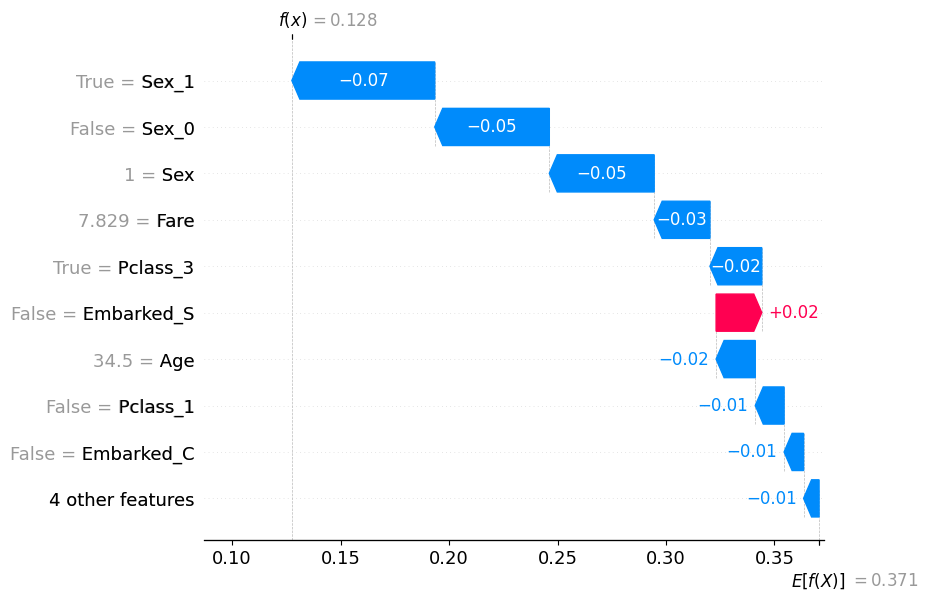

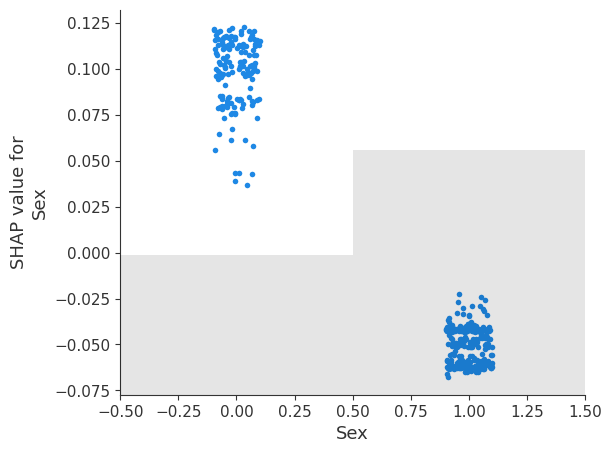

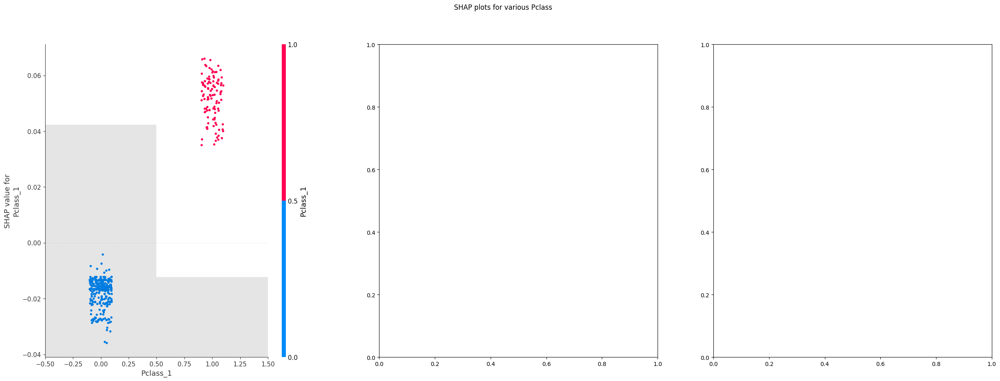

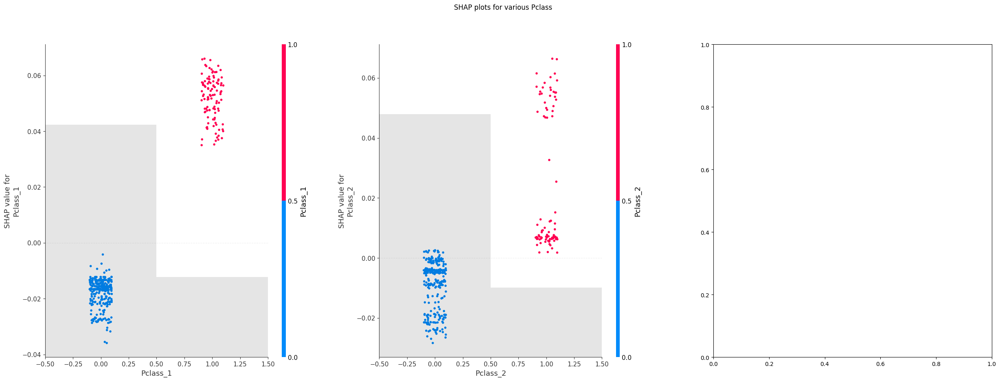

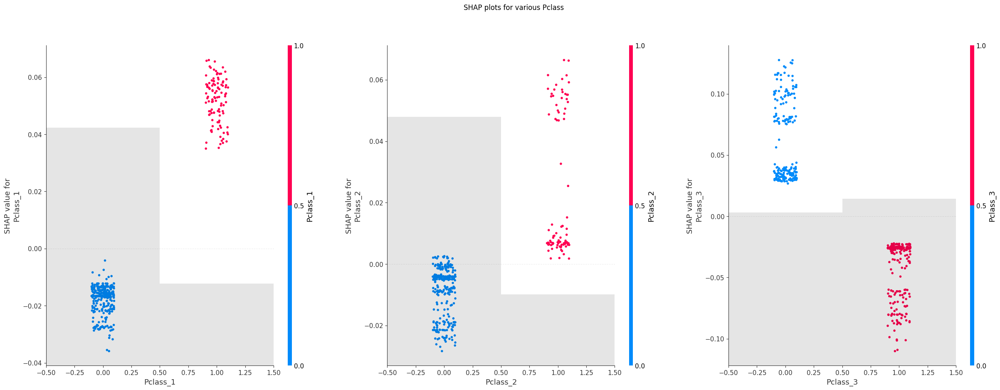

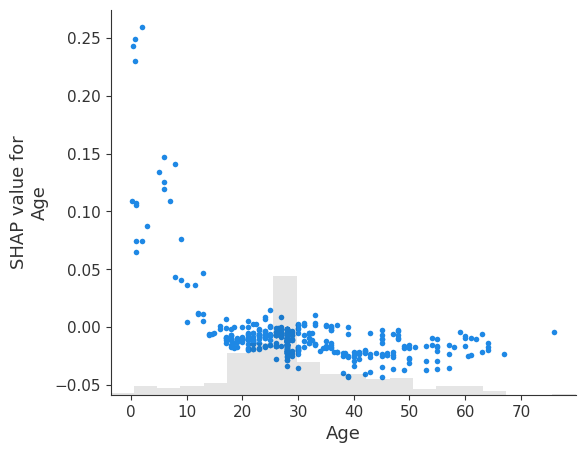

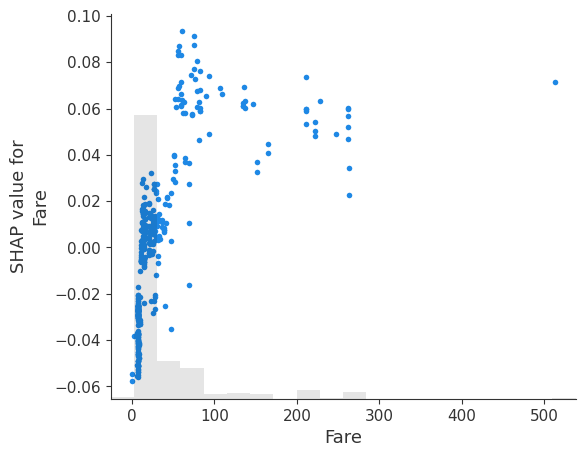

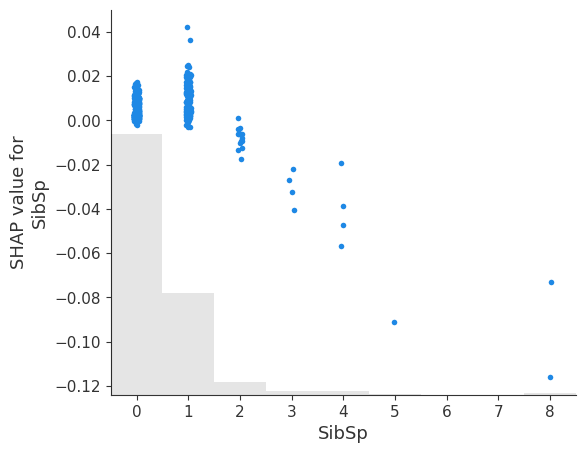

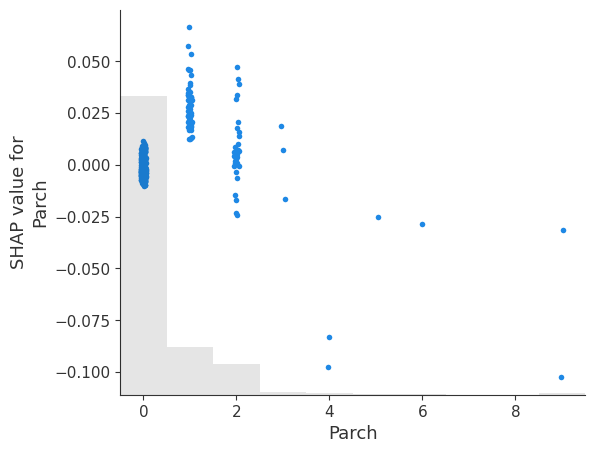

In [ ]:
# SHAP Analysis
print("\nPerforming SHAP analysis to interpret the model...")
explainer = shap.TreeExplainer(rfc1)
shap_values = explainer(X_test)



# Visualizations
# Waterfall plot for the first sample
no = 0  # Change this index to visualize a different passenger's prediction explanation
if rfc1.predict(np.expand_dims(X_test.iloc[no], axis=0))[0] == 1:
    print("The passenger survived")
else:
    print("The passenger did not survive")
shap.plots.waterfall(shap_values[no,:,1])

# SHAP feature-wise visualizations

shap.plots.scatter(shap_values[:,"Sex",1])
f, axes = plt.subplots(1,3, figsize=(30, 10))
f.suptitle("SHAP plots for various Pclass")
shap.plots.scatter(shap_values[:,"Pclass_1",1], color=shap_values[:,"Pclass_1",1],ax = axes[0])
shap.plots.scatter(shap_values[:,"Pclass_2",1], color=shap_values[:,"Pclass_2",1],ax = axes[1])
shap.plots.scatter(shap_values[:,"Pclass_3",1], color=shap_values[:,"Pclass_3",1],ax = axes[2])
shap.plots.scatter(shap_values[:,"Age",1])
shap.plots.scatter(shap_values[:,"Fare",1])
shap.plots.scatter(shap_values[:,"SibSp",1])
shap.plots.scatter(shap_values[:,"Parch",1])
